# Install Required Packages

In [132]:
# Install imager package (Very Slow Install)
install.packages("imager")

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

also installing the dependencies ‘bmp’, ‘tiff’, ‘png’, ‘jpeg’, ‘readbitmap’, ‘downloader’, ‘igraph’




In [134]:
library(imager)

Loading required package: magrittr


Attaching package: ‘imager’


The following object is masked from ‘package:magrittr’:

    add


The following objects are masked from ‘package:stats’:

    convolve, spectrum


The following object is masked from ‘package:graphics’:

    frame


The following object is masked from ‘package:base’:

    save.image




In [133]:
# Allows for greater colour pallettes
install.packages("RColorBrewer")

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)



In [ ]:
library(RColorBrewer)

In [116]:
# Allows for GET requests to APIs to more easily be handled
install.packages("httr")

# Require package httr
require("httr")
library(httr)

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

Loading required package: httr



In [117]:
install.packages('repr')
library(repr)

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)



In [ ]:
library(lattice)

In [171]:
# Increase plot display size to allow for easier reading
options(repr.plot.width=13, repr.plot.height=13)


# Introduction

Within this report I will attempt to examine and investigate the relationship between weather and the number of traffic collisions in New York City, with the goal of building sufficient knowledge to gain insights about potential links and correlations that can be used to inform decisions by local emergency services.

# Methodology 

The methodology I be following during this report is to acquire relevent datasets from Google's BigQuery cloud service.  I will examine data releveant to all of New York City (NYC), and then refine the data as data requirements change or further more detailed investigation is required of specifc types of data.


**Initial Exploratory Steps** 

I began investigation of the data by first creating a collated dataset for the whole of New York City, of the number of traffic collisions combined with the weather data, for the period 2012 to 2020 using Google's BigQuery.

The collision dataset included details of Motor Vehicle Collisions in New York City by the New York Police Department (NYPD), from 2012 to 2020 (console.cloud.google.com 2020).

The weather dataset included records of temperature, wind and percipitation from New York's Central Park weather station.  A data view for the years 2012 to 2020 was then created to allow for date matching during collation of the collision data for the same years.

**Query - Creating view of weather data for NYC from 2012 to 2020.**
```
CREATE VIEW `uhi-project-289113.assignment_guide.weather_2012_to_2020` AS
SELECT DATE(CAST(year as INT64), CAST(mo as INT64), CAST(da as INT64)) as date,
year, mo, da, temp, dewp, slp, visib, wdsp, mxpsd, gust, max, min, prcp, sndp, fog
FROM `bigquery-public-data.noaa_gsod.gsod2012` WHERE stn='725060'
union all
SELECT DATE(CAST(year as INT64), CAST(mo as INT64), CAST(da as INT64)) as date,
year, mo, da, temp, dewp, slp, visib, wdsp, mxpsd, gust, max, min, prcp, sndp, fog
FROM `bigquery-public-data.noaa_gsod.gsod2013` WHERE stn='725060'
union all
SELECT DATE(CAST(year as INT64), CAST(mo as INT64), CAST(da as INT64)) as date,
year, mo, da, temp, dewp, slp, visib, wdsp, mxpsd, gust, max, min, prcp, sndp, fog
FROM `bigquery-public-data.noaa_gsod.gsod2014` WHERE stn='725060'
union all
SELECT DATE(CAST(year as INT64), CAST(mo as INT64), CAST(da as INT64)) as date,
year, mo, da, temp, dewp, slp, visib, wdsp, mxpsd, gust, max, min, prcp, sndp, fog
FROM `bigquery-public-data.noaa_gsod.gsod2015` WHERE stn='725060'
union all
SELECT DATE(CAST(year as INT64), CAST(mo as INT64), CAST(da as INT64)) as date,
year, mo, da, temp, dewp, slp, visib, wdsp, mxpsd, gust, max, min, prcp, sndp, fog
FROM `bigquery-public-data.noaa_gsod.gsod2016` WHERE stn='725060'
union all
SELECT DATE(CAST(year as INT64), CAST(mo as INT64), CAST(da as INT64)) as date,
year, mo, da, temp, dewp, slp, visib, wdsp, mxpsd, gust, max, min, prcp, sndp, fog
FROM `bigquery-public-data.noaa_gsod.gsod2017` WHERE stn='725060'
union all
SELECT DATE(CAST(year as INT64), CAST(mo as INT64), CAST(da as INT64)) as date,
year, mo, da, temp, dewp, slp, visib, wdsp, mxpsd, gust, max, min, prcp, sndp, fog
FROM `bigquery-public-data.noaa_gsod.gsod2018` WHERE stn='725060'
union all
SELECT DATE(CAST(year as INT64), CAST(mo as INT64), CAST(da as INT64)) as date,
year, mo, da, temp, dewp, slp, visib, wdsp, mxpsd, gust, max, min, prcp, sndp, fog
FROM `bigquery-public-data.noaa_gsod.gsod2019` WHERE stn='725060'
union all
SELECT DATE(CAST(year as INT64), CAST(mo as INT64), CAST(da as INT64)) as date,
year, mo, da, temp, dewp, slp, visib, wdsp, mxpsd, gust, max, min, prcp, sndp, fog
FROM `bigquery-public-data.noaa_gsod.gsod2020` WHERE stn='725060'
ORDER BY year, mo, da

```


**Query** - **Creating Table of collated datasets of weather and collisions from 2012 to 2020**.
```
CREATE TABLE `uhi-project-289113.assignment_guide.collated_collision_data_final`
AS SELECT day, year, mo, da, collision_date, temp, dewp, slp, visib, wdsp,
mxpsd, gust, max, min, prcp, sndp, fog, NUM_COLLISIONS 
FROM `uhi-project-289113.assignment_guide.weather_2012_to_2020` as weather,
`uhi-project-289113.assignment_guide.collision_data_count_final` as complaints
WHERE complaints.collision_date = weather.date;
```




# Overview of collision and weather data for all of New York City (NYC).

I began by viewing the collated data of collisions and weather data for all of NYC.

In [7]:
# View collated data of collisions and weather for each day 2012-2020
nyc_collisions_per_day <- read.csv("https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-collated_collision_numbers_per_day_nyc.csv")

In [8]:
# Check data column headings
 head(nyc_collisions_per_day)

,day,year,mo,da,collision_date,temp,dewp,slp,visib,wdsp,mxpsd,gust,max,min,prcp,sndp,fog,NUM_COLLISIONS
,<int>,<int>,<int>,<int>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>
1,7,2012,7,1,2012-07-01,83.6,63.0,1008.9,9.7,4.1,9.9,18.1,93.0,66.0,0.00,999.9,0,538
2,1,2012,7,2,2012-07-02,80.3,54.1,1011.6,10.0,3.8,15.0,999.9,88.0,66.9,0.00,999.9,0,564
3,2,2012,7,3,2012-07-03,79.8,56.7,1012.8,10.0,2.9,12.0,999.9,88.0,63.0,0.00,999.9,0,664
4,3,2012,7,4,2012-07-04,81.8,65.6,1009.1,9.2,3.6,11.1,999.9,91.0,68.0,0.06,999.9,0,432
5,4,2012,7,5,2012-07-05,86.7,64.3,1007.4,9.4,3.8,15.0,999.9,93.9,70.0,99.99,999.9,0,591
6,5,2012,7,6,2012-07-06,81.9,62.3,1011.7,10.0,3.1,9.9,999.9,91.0,66.9,0.00,999.9,0,638


In [ ]:
# View statistical summary of data
summary(nyc_collisions_per_day)

      day             year            mo              da       
 Min.   :1.000   Min.   :2012   Min.   : 1.00   Min.   : 1.00  
 1st Qu.:2.000   1st Qu.:2014   1st Qu.: 4.00   1st Qu.: 8.00  
 Median :4.000   Median :2016   Median : 7.00   Median :16.00  
 Mean   :3.999   Mean   :2016   Mean   : 6.58   Mean   :15.64  
 3rd Qu.:6.000   3rd Qu.:2018   3rd Qu.:10.00   3rd Qu.:23.00  
 Max.   :7.000   Max.   :2020   Max.   :12.00   Max.   :31.00  
 collision_date          temp            dewp              slp       
 Length:3121        Min.   : 5.80   Min.   :   -6.7   Min.   :  989  
 Class :character   1st Qu.:41.20   1st Qu.:   32.6   1st Qu.: 1012  
 Mode  :character   Median :52.50   Median :   45.7   Median : 1017  
                    Mean   :52.23   Mean   :   47.8   Mean   : 1192  
                    3rd Qu.:64.70   3rd Qu.:   59.0   3rd Qu.: 1022  
                    Max.   :86.70   Max.   : 9999.9   Max.   :10000  
     visib             wdsp           mxpsd             gust  

From examination of the summary displayed above, I noticed that there were several headings and data source types that appeared to be worth exploring when investigating whether there exists a link between weather and the number of collisions.  

I began by comparing the number of collisions against different weather phenomenon to identify whether a link could be indentified between collision numbers per day and any particular type of weather.

# Wind Speed

I checked if wind speed had an effect on the number of collisions.

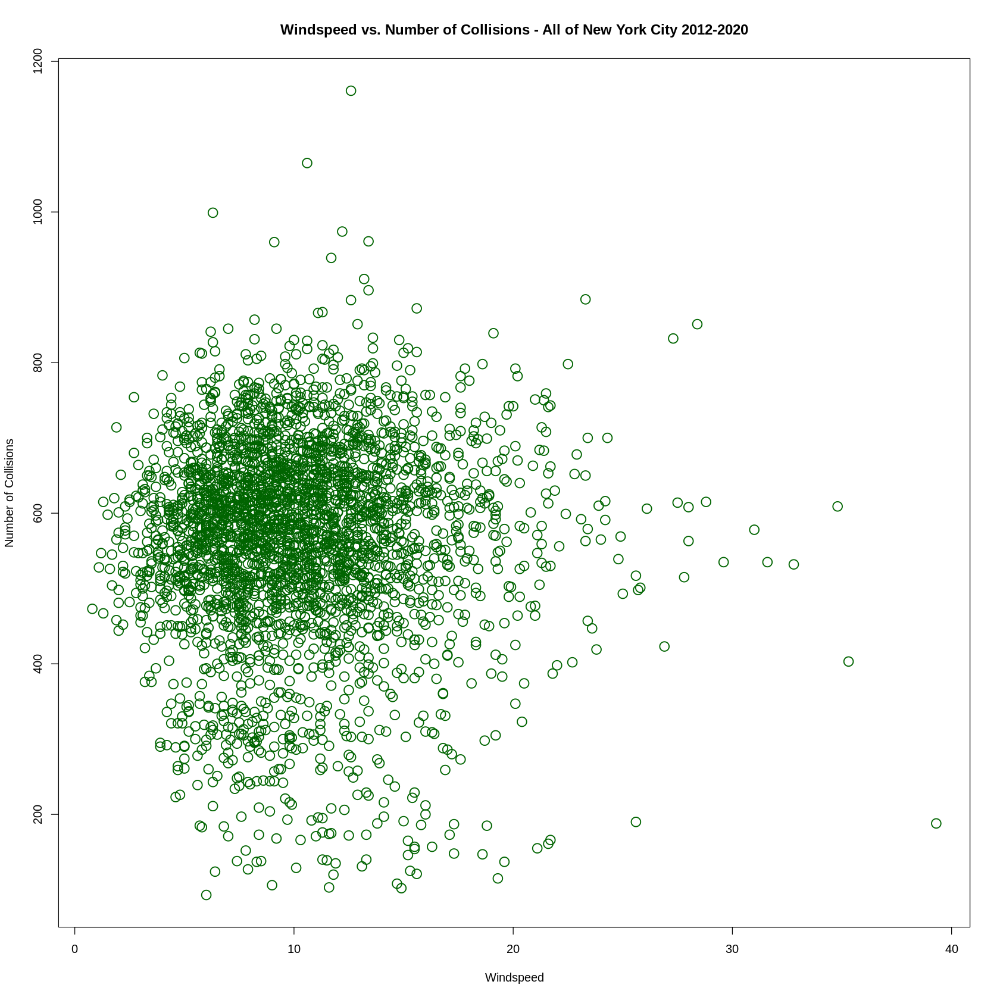

In [14]:
## Create plot of wind speed against number of collisions for all of NYC
plot (nyc_collisions_per_day$wdsp, nyc_collisions_per_day$NUM_COLLISIONS, xlab = "Windspeed", ylab = "Number of Collisions",  col = "darkgreen", 
pch = 1, cex=1.75, lwd=1.5, main="Windspeed vs. Number of Collisions - All of New York City 2012-2020") 

From the above plot of windspeed versus collisions, there does not appear to be any significant impact from windspeed on collision numbers, with most collisions occuring during periods of very low windspeed.

I then created a scatter plot to gain an overview of data related to percipitation and visibility.

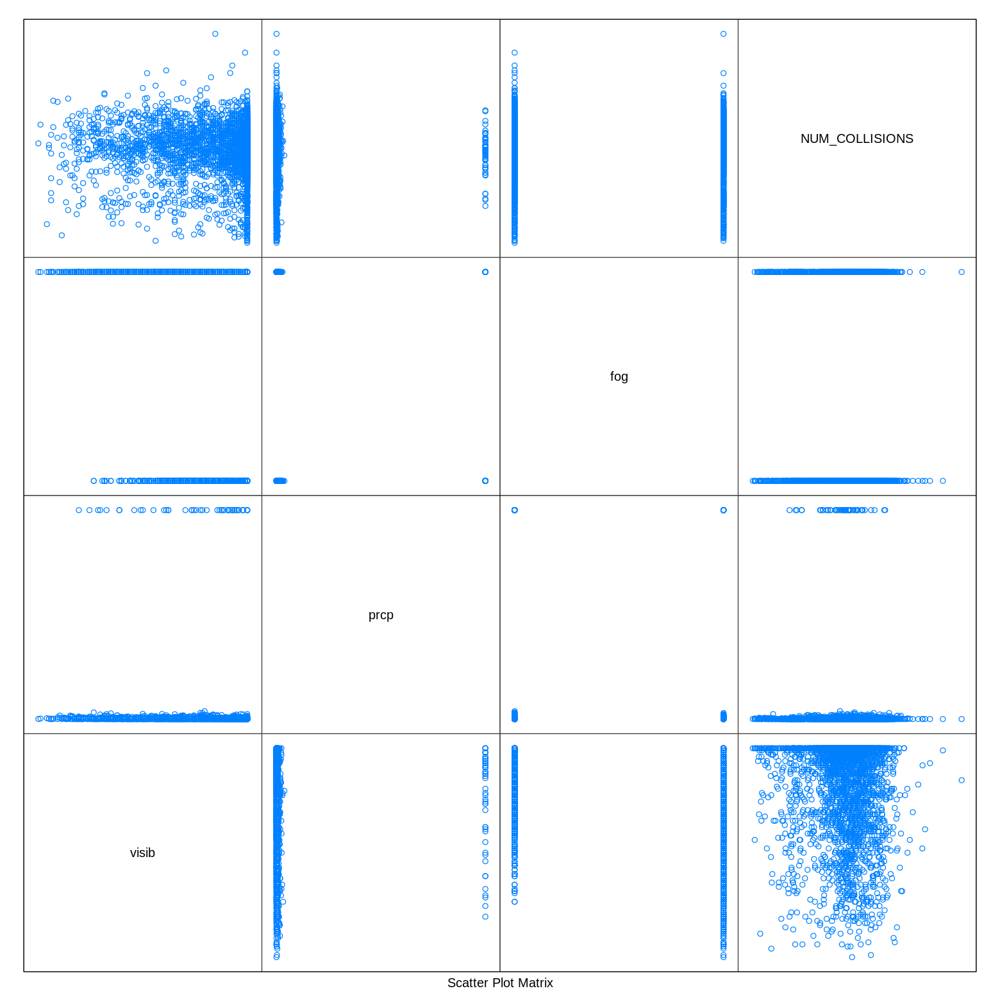

In [205]:
splom(~ nyc_collisions_per_day[,c(9, 15, 17, 18)], groups=NULL, data=nyc_collisions_per_day,
axis.line.tck=0, axis.text.alpha=0)

From the above scatterplot I decided to investigate percipitation, visibility and fog more closely.

---



# Percipitation

I checked if percipitation had an effect on the number of collisions.

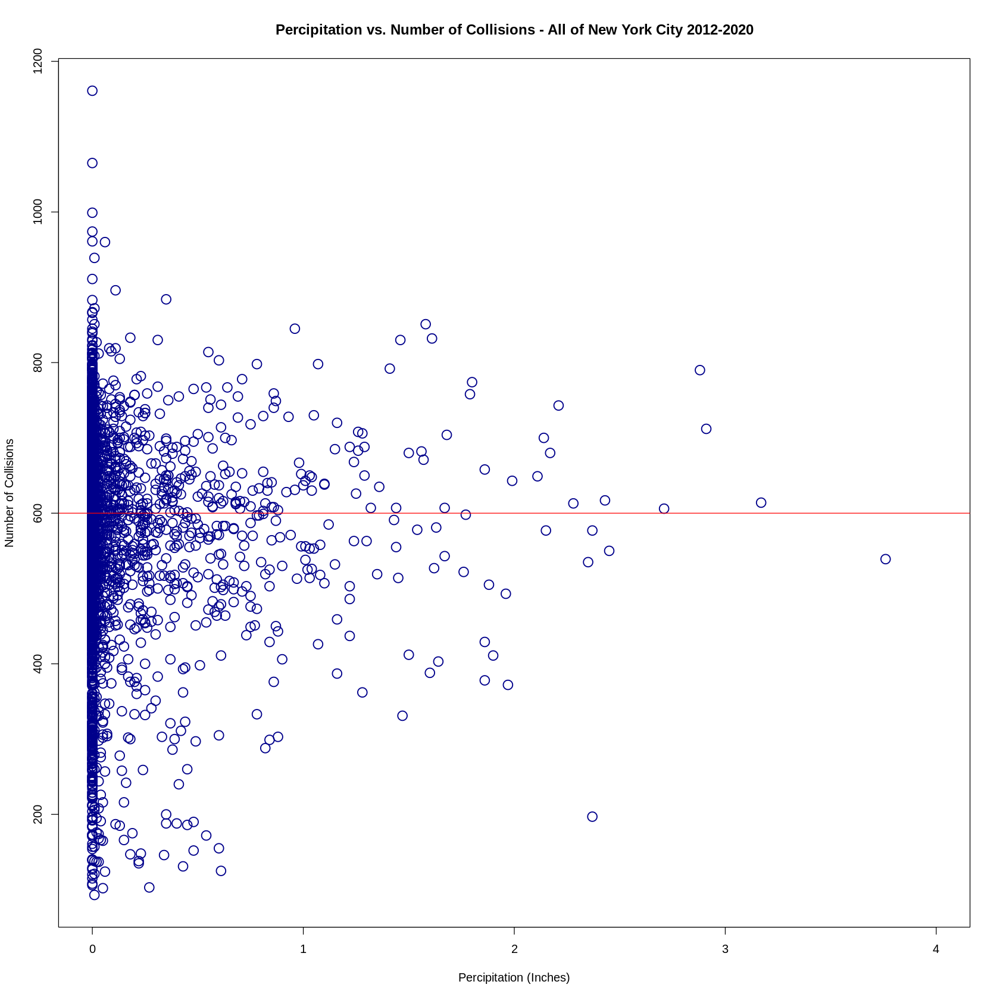

In [38]:
## Create plot of percipitation against number of collisions for all of NYC
plot (nyc_collisions_per_day$prcp, nyc_collisions_per_day$NUM_COLLISIONS, 
xlim=c(0,4), xlab = "Percipitation (Inches)", ylab = "Number of Collisions", col = "darkblue", 
pch = 1, cex=1.75, lwd=1.5, main="Percipitation vs. Number of Collisions - All of New York City 2012-2020") 
abline(h=600, col="red")

From the above plot for percipitation, it can seen that there is no  identificable rise in collisions as percipitation increases.

# Fog

I checked if fog had an effect on the number of collisions.

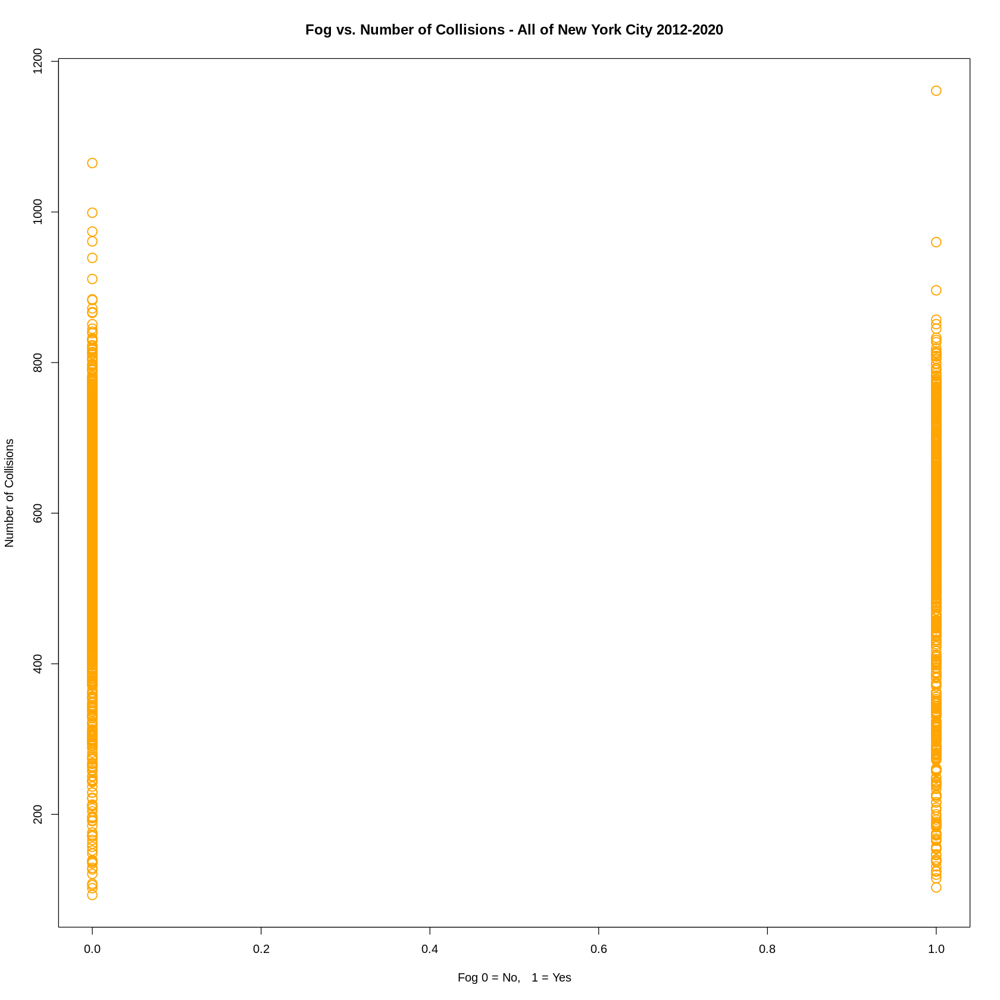

In [39]:
## Create plot of fog against number of collisions for all of NYC
plot (nyc_collisions_per_day$fog, nyc_collisions_per_day$NUM_COLLISIONS, 
xlim=c(0,1), xlab = "Fog 0 = No,   1 = Yes", ylab = "Number of Collisions",  col = "orange", 
pch = 1, cex=1.75, lwd=1.5, main="Fog vs. Number of Collisions - All of New York City 2012-2020") 

From the plot of fog against number of collisions, it can be seen that there does appear to be a rise in the number of collision when fog is present.  Although if the upper value fog present outlier was removed from the data, there would be greater numbers of collisions on days without fog.  

# Visibility

I checked if visibility had an effect on the number of collisions.

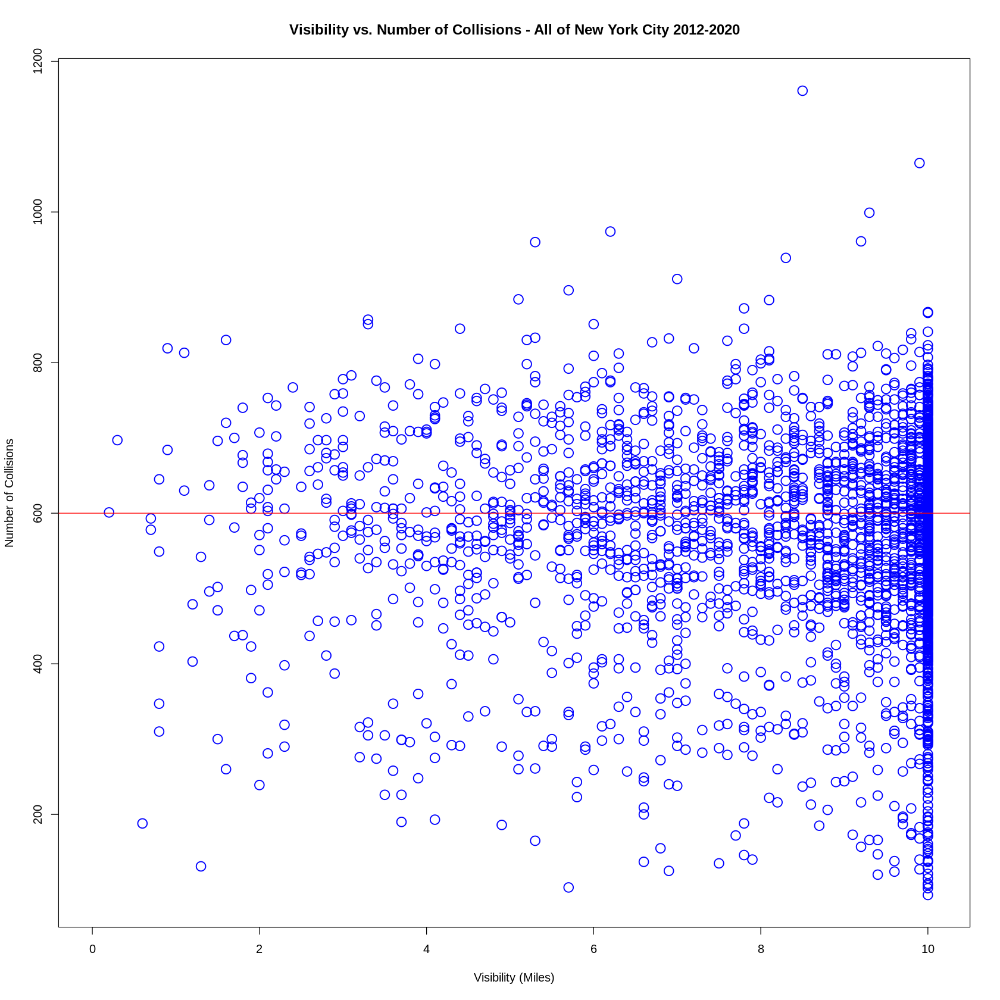

In [37]:
## Create plot of visibility against number of collisions for all of NYC
plot (nyc_collisions_per_day$visib, nyc_collisions_per_day$NUM_COLLISIONS, 
xlim=c(0,10.1), xlab = "Visibility (Miles)", ylab = "Number of Collisions",  col = "blue", 
pch = 1, cex=1.75, lwd=1.5, main="Visibility vs. Number of Collisions - All of New York City 2012-2020") 
abline(h=600, col="red")

From the above plot of visibility, there does not appear to be any increase in the average number of collisions per day as visibility decreases.  This could be due to the fact that average vehicle speeds within a city are generally lower, and in combination with the environment and lighting of built up areas within a city, make the contribution of fog to accident rates much less significant than would be the case in fast, open roads like highways.

# Week Day


I decided to check if the day of the week was a contributing factor to the number of collisions.

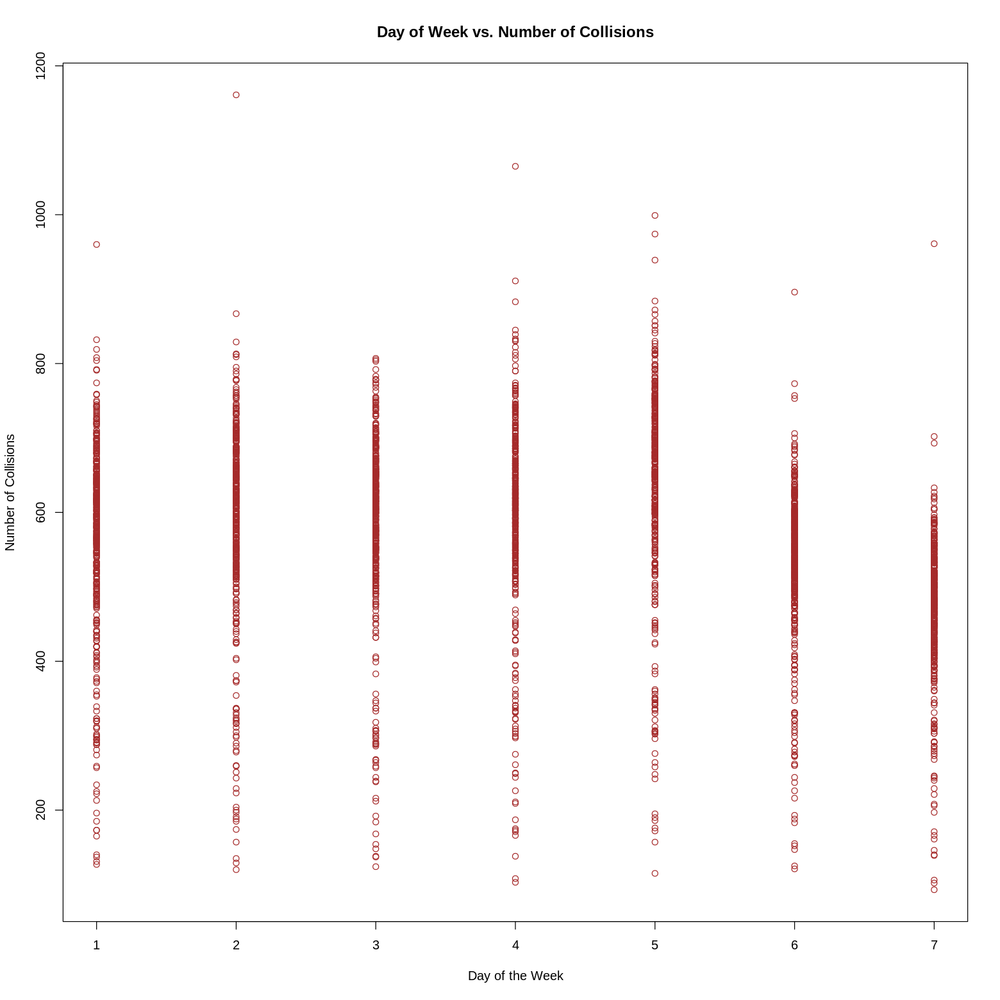

In [172]:
plot (nyc_collisions_per_day$day, nyc_collisions_per_day$NUM_COLLISIONS, xlab = "Day of the Week", ylab = "Number of Collisions", 
main="Day of Week vs. Number of Collisions", col="brown")

From the above plot, it can be seen that there is a rise in the number of collisions per day on day 5 (Friday), and a significant decrease in the number of collisions that occur on days 6 and 7 (Saturday and Sunday).  The additional apparent rise in collisions on Friday could be due to commuters returning home after working away all week, and the reduction of collision on weekend days, could be due to less traffic on the road network as less people journey to and from work.

# Temperature

I then decided to check if temperature had an effect on the number of collisions.

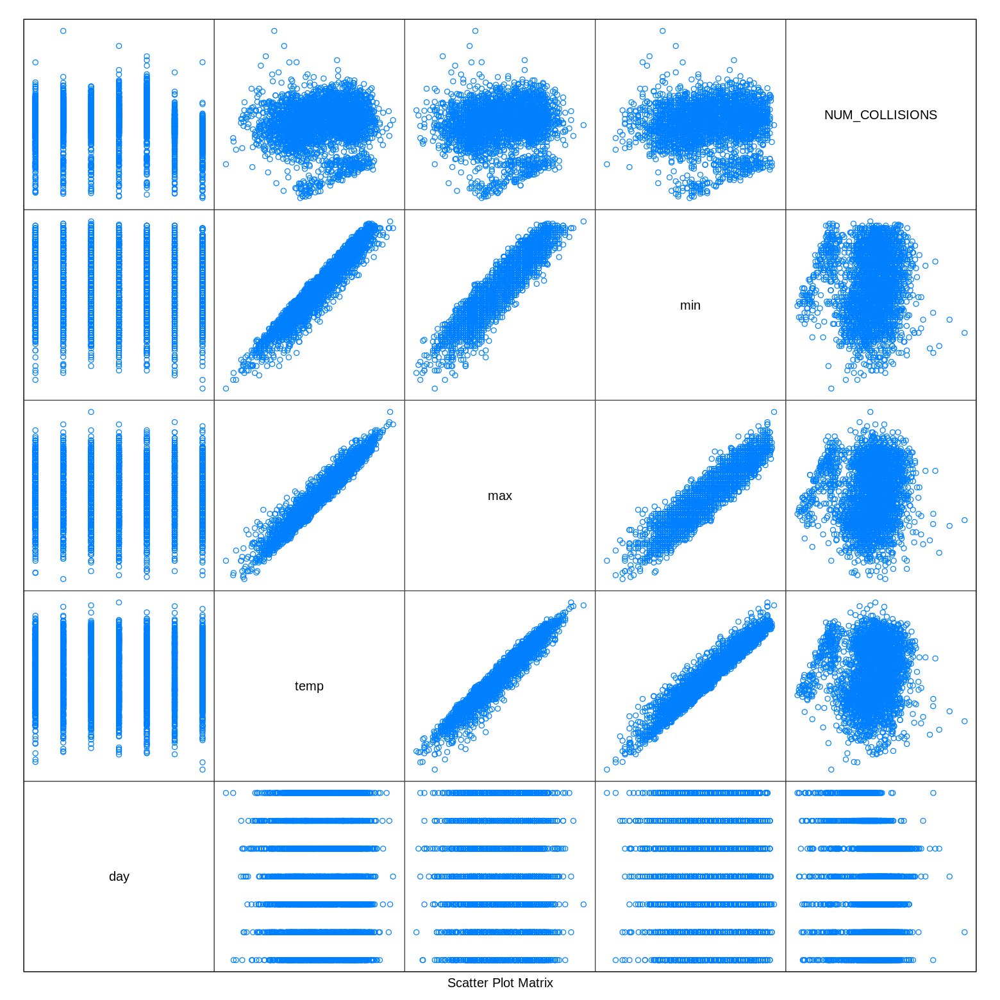

In [202]:
splom(~ nyc_collisions_per_day[,c(1,6, 13, 14,18)], groups=NULL, data=nyc_collisions_per_day,
axis.line.tck=0, axis.text.alpha=0)

From the above scatter plot, I decided to investigate mean temperature more closely.

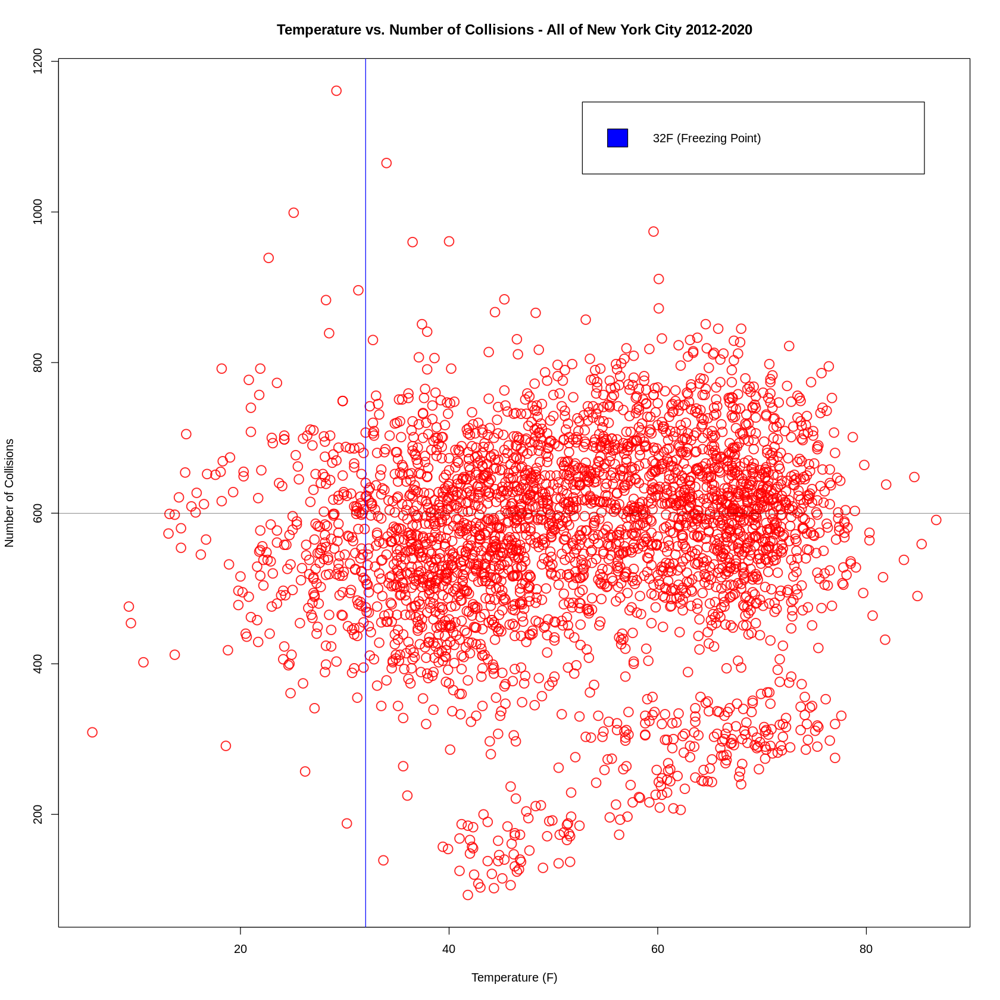

In [66]:
## Create plot of temperature against number of collisions for all of NYC
plot (nyc_collisions_per_day$temp, nyc_collisions_per_day$NUM_COLLISIONS, xlab = "Mean Temperature (F)", ylab = "Number of Collisions",  col = rgb(1, 0, 0, 0.85), 
pch = 1, cex=1.75, lwd=1.5, main="Mean Temperature vs. Number of Collisions - All of New York City 2012-2020") 
legend("topright", inset=.05,  c("32F (Freezing Point)"), fill="blue")
abline(v=32, col="blue")
abline(h=600, lwd=0.4)

Smooth scatterplot version to help identify regions of data with higher density

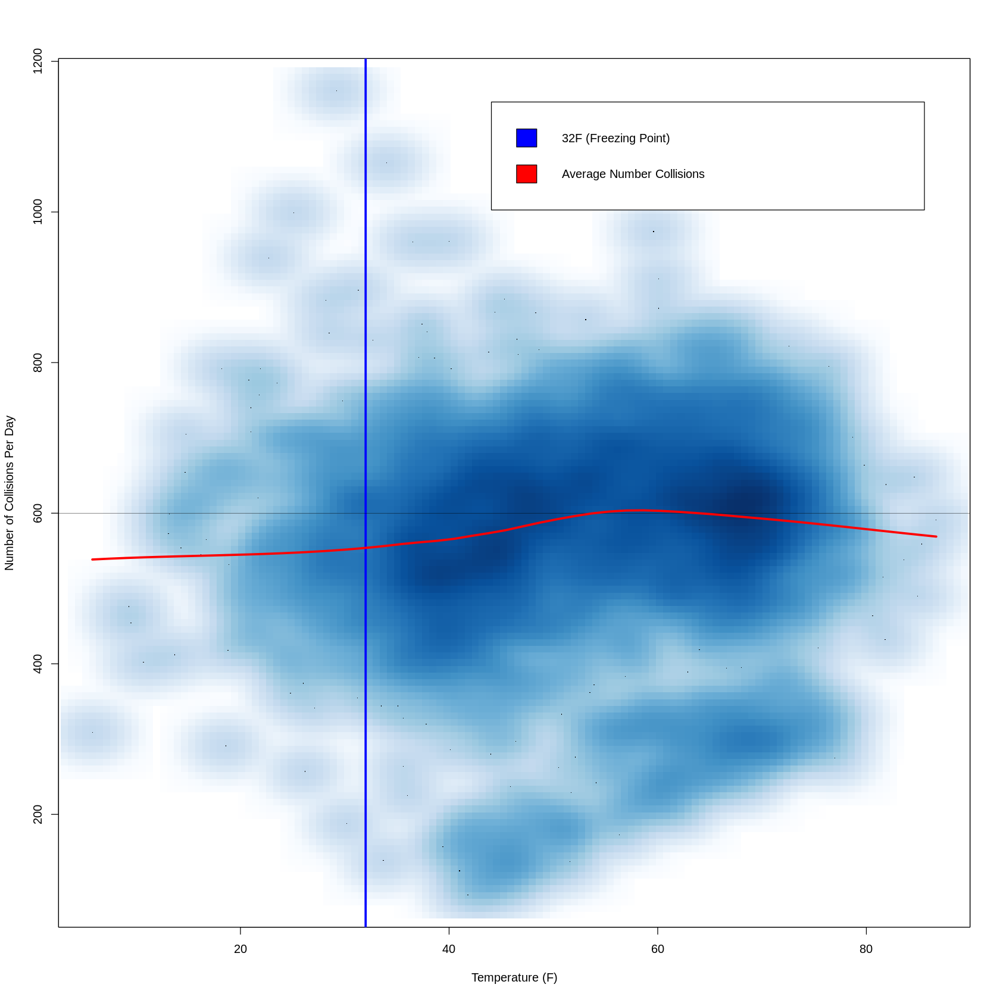

In [62]:
# SmoothScatter plot of temperature against number of collisions
set.seed(1)
smoothScatter(nyc_collisions_per_day$temp, nyc_collisions_per_day$NUM_COLLISIONS, lwd=3, xlab = "Temperature (F)", ylab = "Number of Collisions Per Day")
legend("topright", inset=.05,  legend = c("32F (Freezing Point)", "Average Number Collisions"), fill = c("blue", "red"))
abline(v=32, col="blue", cex=1, lwd=3) 
abline(h=600, lwd=0.4)
lines(loess.smooth(nyc_collisions_per_day$temp, nyc_collisions_per_day$NUM_COLLISIONS), lwd = 3, col="red")

From the above temperature plots, it can be seen that as the temp decreases towards freezing (32 F), although there are days whose total number of collisions is greater than occurs during warmer periods, I would consider these as rare outliers, and they can probably be dismissed as unrepresentational.  

The general trend after outliers are ignored on the other hand, is that the average number of collisions per day actually seems to increase slightly as temperature increases, to a peak density at approximately 55 F, which is well above freezing.  


The results of plotting this data was surprising, and I feel there must be other factors at play, such as potentially greater volumes of traffic during warmer weather.

Based on the concept that there are more collisions during warmer months than the colder months, it may be the case that collisions occurring during colder conditions could be more serious with greater numbers of resultant injuries or deaths, due to lower temperatures, ice or other factors.

To investigate this hypothesis, I decided to create seasonal views of the data, comparing the extremes of winter and summer for collisions.  In addition, I intended to examine whether the severity of collisions differs between winter and summer months.

# Create View of number of injuries per day

I decided to initially create a view of the injury rate across all seasons to allow for a baseline comparison.


**Query - Create View Injury Rates Per Date**
```
#standardSql
CREATE VIEW `uhi-project-289113.assignment_guide.injuries_killed_count_final_nyc1` 
AS SELECT CAST(timestamp as DATE) as collision_date, SUM(number_of_persons_injured) AS NUM_injuries, SUM(number_of_persons_killed) AS NUM_deaths,
FROM `bigquery-public-data.new_york_mv_collisions.nypd_mv_collisions` AS collisions 
WHERE borough IS NOT NULL
GROUP BY collision_date 
```

**Query - Get view of data**
```
SELECT * FROM `uhi-project-289113.assignment_guide.injuries_killed_count_final_nyc1`
Order by collision_date
``` 

https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-Injuries_deaths_per_day.csv

In [69]:
# Check injury rates per day
injury_types_all_NYC_2012_2020 <- read.csv("https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-Injuries_deaths_per_day.csv")

In [70]:
head(injury_types_all_NYC_2012_2020)

,collision_date,NUM_injuries,NUM_deaths
,<chr>,<int>,<int>
1,2012-07-01,128,0
2,2012-07-02,131,1
3,2012-07-03,167,1
4,2012-07-04,110,0
5,2012-07-05,110,1
6,2012-07-06,150,0


In [71]:
summary(injury_types_all_NYC_2012_2020)

 collision_date      NUM_injuries     NUM_deaths    
 Length:3075        Min.   :  6.0   Min.   :0.0000  
 Class :character   1st Qu.: 86.5   1st Qu.:0.0000  
 Mode  :character   Median :102.0   Median :0.0000  
                    Mean   :101.4   Mean   :0.4426  
                    3rd Qu.:118.0   3rd Qu.:1.0000  
                    Max.   :196.0   Max.   :9.0000  

Create histogram to gain overview of average number of injuries for all of NYC.

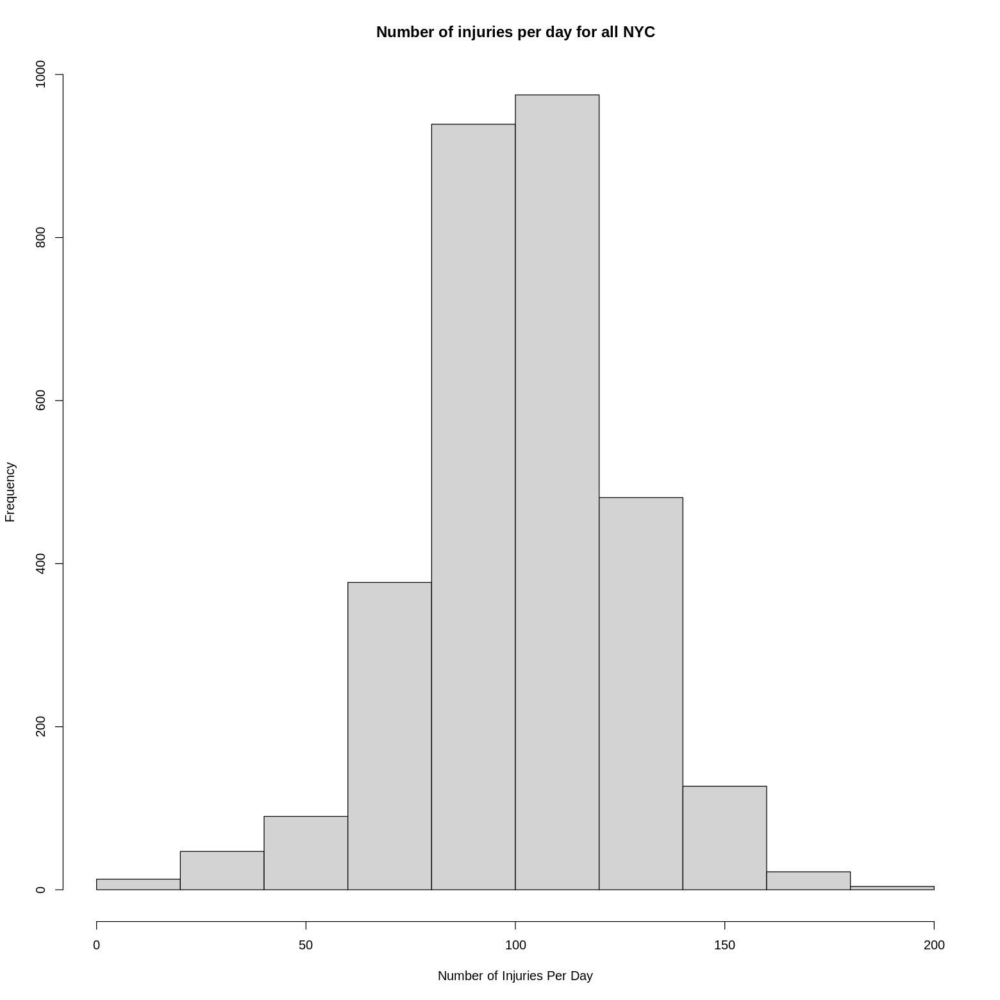

In [173]:
hist(injury_types_all_NYC_2012_2020$NUM_injuries, xlab = "Number of Injuries Per Day", main = "Number of injuries per day for all NYC")


From the above histogram, it can be seen that the average number of injuries from collisions per day for the whole of NYC is approximately 100.


I next needed to investigate whether seasonal injury and death rates varied between summer and winter months, to determine whether the hypothesis that colder weather results in more serious collisions was true or not. To test this hypothesis I needed to extract the number of injuries and deaths for individual collisions.

# Seasonal Injury and Death rates Per Collision

**Query - Create view of all NYC injury and death data for all years**
```
#standardSql
CREATE VIEW `uhi-project-289113.assignment_guide.injuries_killed__NYC_ALLYEARS` 
AS SELECT CAST(timestamp as DATE) as collision_date, EXTRACT(YEAR FROM timestamp) AS year, EXTRACT(MONTH FROM timestamp) AS mo, SUM(number_of_persons_injured) AS NUM_injuries, SUM(number_of_persons_killed) AS NUM_deaths,
FROM `bigquery-public-data.new_york_mv_collisions.nypd_mv_collisions` AS collisions 
WHERE borough IS NOT NULL
GROUP BY timestamp 
ORDER BY timestamp asc;
```

**Query - Get View of all NYC injuries and deaths occuring over summer months for all years**
```
#standardSql
SELECT * FROM `uhi-project-289113.assignment_guide.injuries_killed__NYC_ALLYEARS`
WHERE mo BETWEEN 6 AND 8 AND (NUM_deaths > 0 AND NUM_injuries > 0 OR NUM_deaths > 0 OR NUM_injuries > 0)
ORDER BY NUM_deaths desc
#ORDER BY collision_date asc
```
https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/assignment1_all_nyc_summer_injuries_deaths_2012-2020.csv

**Query - Get view of all NYC injuries and deaths occuring over winter months for all years**
```
#standardSql
SELECT * FROM `uhi-project-289113.assignment_guide.injuries_killed__NYC_ALLYEARS`
WHERE (NUM_deaths <> 0 OR NUM_injuries <> 0) AND (mo = 12 OR mo = 1 OR mo = 2)
ORDER BY NUM_deaths desc
```
https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/assignment1_all_nyc_winter_injuries_deaths_2012-2020.csv


**Investigation of collision rates for all Winter months, for all of NYC**

In [74]:
injury_deaths_all_winters_2012_2020 <- read.csv("https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/assignment1_all_nyc_winter_injuries_deaths_2012-2020.csv")

In [ ]:
head(injury_deaths_all_winters_2012_2020)

,collision_date,year,mo,NUM_injuries,NUM_deaths
,<chr>,<int>,<int>,<int>,<int>
1,2012-12-01,2012,12,1,0
2,2012-12-01,2012,12,1,0
3,2012-12-01,2012,12,1,0
4,2012-12-01,2012,12,1,0
5,2012-12-01,2012,12,1,0
6,2012-12-01,2012,12,1,0


In [ ]:
summary(injury_deaths_all_winters_2012_2020)

 collision_date          year            mo          NUM_injuries   
 Length:45467       Min.   :2012   Min.   : 1.000   Min.   : 0.000  
 Class :character   1st Qu.:2014   1st Qu.: 1.000   1st Qu.: 1.000  
 Mode  :character   Median :2016   Median : 2.000   Median : 1.000  
                    Mean   :2016   Mean   : 5.421   Mean   : 1.484  
                    3rd Qu.:2018   3rd Qu.:12.000   3rd Qu.: 2.000  
                    Max.   :2020   Max.   :12.000   Max.   :24.000  
                                                                    
   NUM_deaths      
 Min.   :0.000000  
 1st Qu.:0.000000  
 Median :0.000000  
 Mean   :0.007016  
 3rd Qu.:0.000000  
 Max.   :3.000000  
 NA's   :1         

Checking total number of combined injuries and deaths occuring over the months December, January and February for all years.

In [ ]:
# Check number of injuries and deaths occuring for winter months Dec, Jan, Feb
table(injury_deaths_all_winters_2012_2020$mo)


    1     2    12 
15079 13328 17060 

From the total combined injury and death numbers above, it can be seen that a greater number of injuries and deaths occured during the December months between 2012 and 2020, than other winter months, and that the total number of injuries and deaths during the winter months for all years is as follows:

In [ ]:
# Calculate total number of injuries and deaths for the winter months of all years 2012 - 2020
nrow(injury_deaths_all_winters_2012_2020)

[1] 45467

Thus, total number of injuries and deaths for all winter months is **45,467**

Number of days in winter = **90**

Number of winters (2012 to 2019) = **7** 

Total number of winter days = 7 * 90 = **630**

Average injuries and deaths per winter per day = 45467 / 630 = **72**


**Next I checked for differences between injury and death rates per collision, between the summer and winter months**

# Winter Injuries - Per Collision 2012-2020

Plot injury rates per collision for the winter months December, January and February.

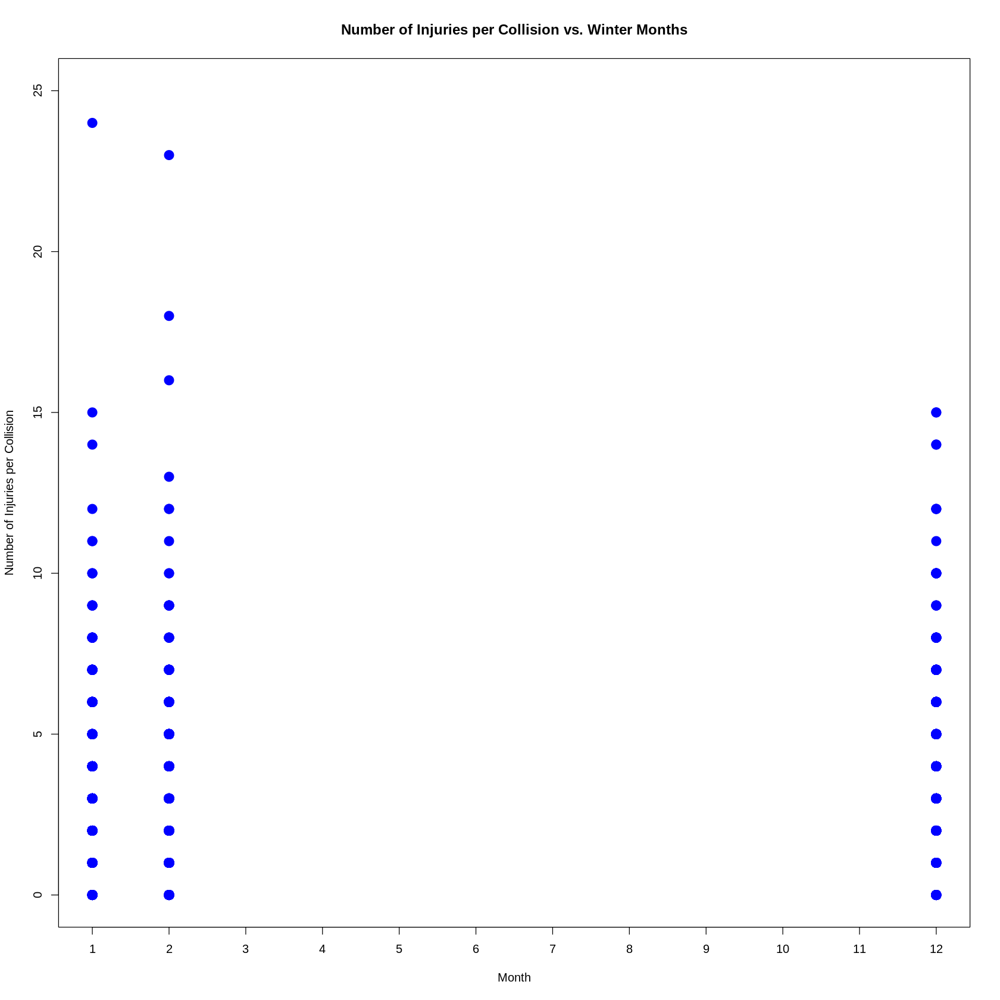

In [76]:
# Plot number of injuries per collision for all summer months June, July, August between 2012 and 2020.
plot(injury_deaths_all_winters_2012_2020$mo, injury_deaths_all_winters_2012_2020$NUM_injuries, 
pch = 19, cex=1.75, col="blue", lwd=1, xlab="Month", ylab="Number of Injuries per Collision", main = "Number of Injuries per Collision vs. Winter Months",
xlim=c(1,12),ylim=c(0,25), xaxt="n")
axis(1,at=1:12,labels=1:12)


From the above plot it can be seen that during the winter months, there can be as many as **24** injuries per collision during the worst injury month, January.

# Winter Deaths - Per collision 2012 - 2020

Plot death rates for the winter months December, January and February.

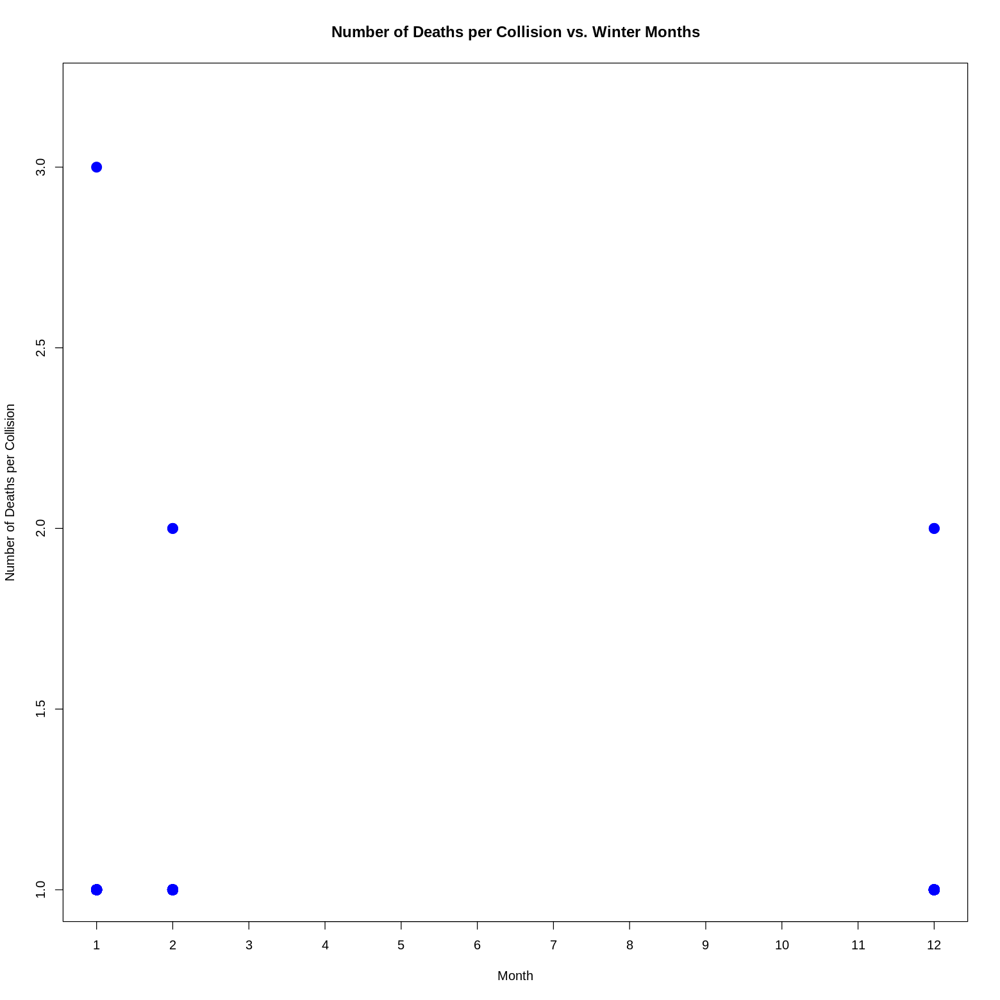

In [174]:
# Plot number of deaths per collision for all summer months June, July, August between 2012 and 2020.
plot(injury_deaths_all_winters_2012_2020$mo, injury_deaths_all_winters_2012_2020$NUM_deaths, 
pch = 19, cex=1.75, col="blue", lwd=1, xlab="Month", ylab="Number of Deaths per Collision", main = "Number of Deaths per Collision vs. Winter Months",
xlim=c(1,12),ylim=c(1,3.2), xaxt="n")
axis(1,at=1:12,labels=1:12)

From the above plot, it can be seen that during the worst month for deaths which like injuries, was also January, there are as many as **3** deaths per collision.

# Summer Injuries - Per collision 2012-2020

In [176]:
injury_deaths_all_summers_2012_2020 <- read.csv("https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/assignment1_all_nyc_summer_injuries_deaths_2012-2020.csv")

In [177]:
head(injury_deaths_all_summers_2012_2020)

,collision_date,year,mo,NUM_injuries,NUM_deaths
,<chr>,<int>,<int>,<int>,<int>
1,2012-07-01,2012,7,1,0
2,2012-07-01,2012,7,4,0
3,2012-07-01,2012,7,1,0
4,2012-07-01,2012,7,1,0
5,2012-07-01,2012,7,1,0
6,2012-07-01,2012,7,1,0


In [ ]:
summary(injury_deaths_all_summers_2012_2020)

 collision_date          year            mo         NUM_injuries   
 Length:56691       Min.   :2012   Min.   :6.000   Min.   : 0.000  
 Class :character   1st Qu.:2014   1st Qu.:6.000   1st Qu.: 1.000  
 Mode  :character   Median :2016   Median :7.000   Median : 1.000  
                    Mean   :2016   Mean   :7.033   Mean   : 1.547  
                    3rd Qu.:2018   3rd Qu.:8.000   3rd Qu.: 2.000  
                    Max.   :2020   Max.   :8.000   Max.   :24.000  
                                                                   
   NUM_deaths      
 Min.   :0.000000  
 1st Qu.:0.000000  
 Median :0.000000  
 Mean   :0.006774  
 3rd Qu.:0.000000  
 Max.   :5.000000  
 NA's   :1         

Check the total number of injuries and deaths which occured throughout all summer months June, July and August 2012 to 2020.

In [178]:
# Check total number of injuries and deaths occuring for summer months June, July, August
table(injury_deaths_all_summers_2012_2020$mo)


    6     7     8 
17512 19821 19358 

From the total injury and death numbers above, it can be seen that a greater number of injuries and deaths occured during the month of July for the years 2012 and 2020, than other summer months, and that the total number of injuries and deaths during the summer months for all years is:

In [ ]:
# Calculate total number of injuries and deaths for the summer months of all years 2012 - 2020
nrow(injury_deaths_all_summers_2012_2020)

[1] 56691

Therefore, the total number of injuries and deaths for the summer months of all years is **56,691**

Days per summer = **92**

Number of summers (2012 to 2020) = **8**

Total number of summer days = 8 * 92 = **736**

Average number injuries and deaths per summer per day = 56691 / 736 = **77**

Plot injury rates per collision for the summer months June, July and August.

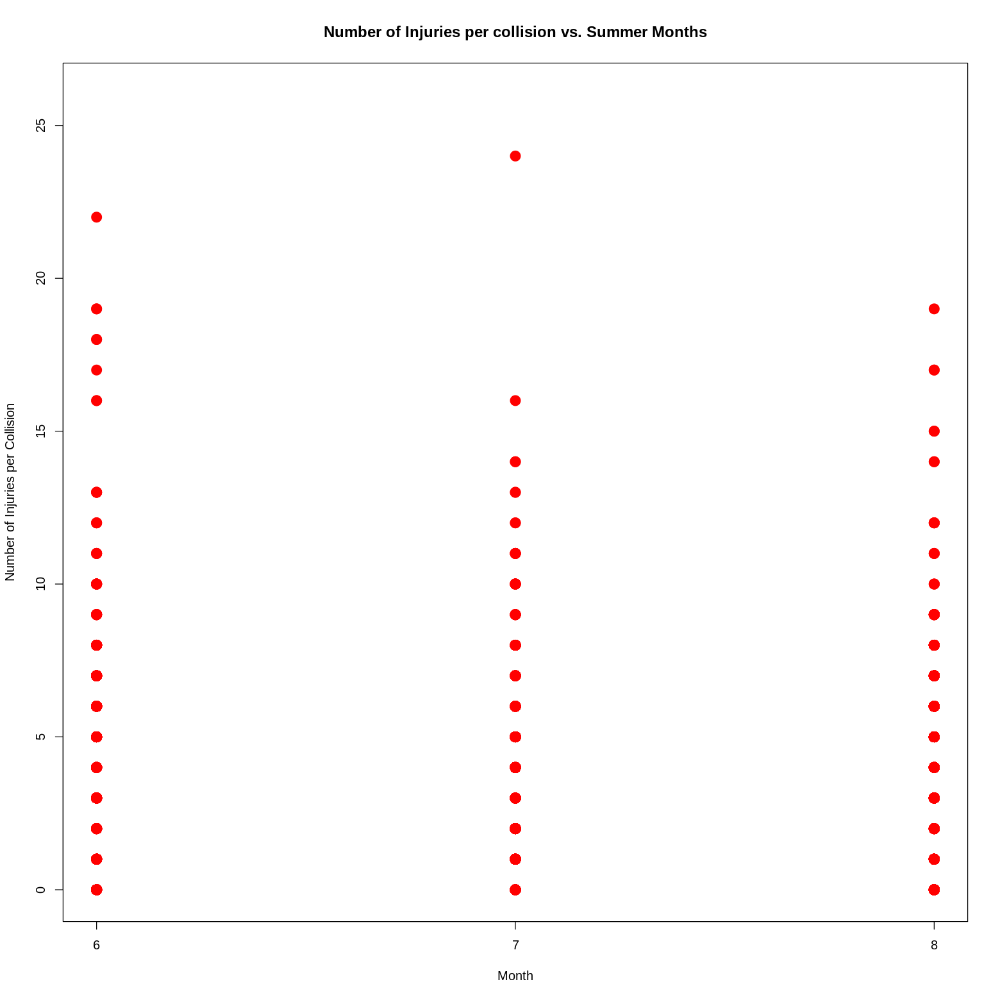

In [179]:
# Plot number of injury totals occuring per day for all summer months June, July, August between 2012 and 2020.
plot(injury_deaths_all_summers_2012_2020$mo, injury_deaths_all_summers_2012_2020$NUM_injuries, 
pch = 19, cex=1.75, col="red", lwd=1, xlab="Month", ylab="Number of Injuries per Collision", main = "Number of Injuries per collision vs. Summer Months",
xlim=c(6,8),ylim=c(0,26), xaxt="n")
axis(1,at=6:8,labels=6:8)


From the above plot it can be seen that there was as many as **24** injuries per collision during the summer months.

# Summer Deaths - Per collision 2012-2020

Plot number of deaths per day for summer to compare against the winter values.

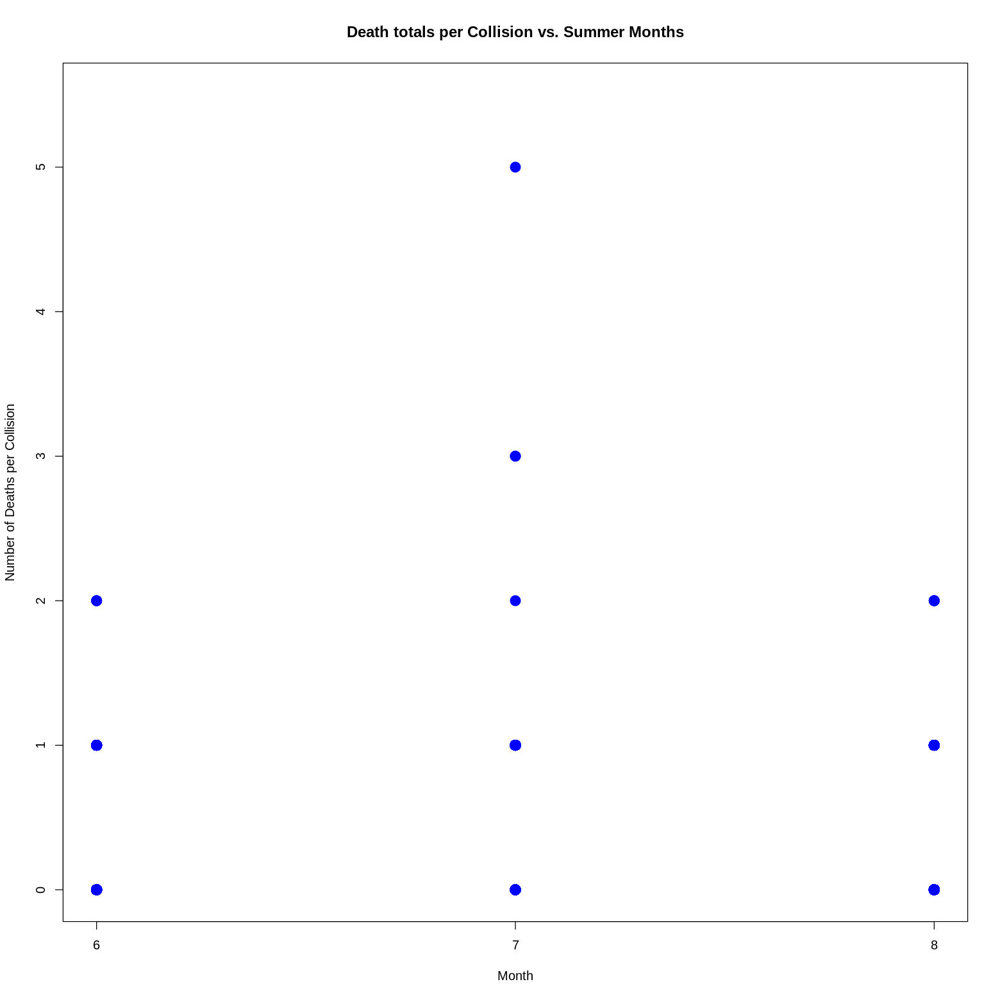

In [180]:
# Plot number of death totals occuring per day for all summer months June, July, August between 2012 and 2020.
plot(injury_deaths_all_summers_2012_2020$mo, injury_deaths_all_summers_2012_2020$NUM_deaths, 
pch = 19, cex=1.75, col="blue", lwd=1, xlab="Month", ylab="Number of Deaths per Collision", main = "Death totals per Collision vs. Summer Months",
xlim=c(6,8),ylim=c(0,5.5), xaxt="n")
axis(1,at=6:8,labels=6:8)

From the above plot, it can be seen that there were as many as **5** deaths per collision during the summer months.

**Summary**

After comparing the death and injury rates between summer and winter months, I found that during the winter months, collisions could result in up to **3** deaths and **24** injuries, and during the summer months collisions could result in up to **5** deaths and also up to **24** injuries.

It was also found that on average, during the summer months NYC can expect to see **77** dead or injured each day as a result of traffic collisions, and during winter that average is lower at **72**.

Based on this information, summer appears to be a more dangerous time of year to be in a collision in NYC.  Since it appears that during summer months there are higher numbers of injuries and deaths per day, and if you are unlucky enough to be involved in a collision during the summer months, there is a higher chance of death; a surprising and unintuitive result that needs further investigation.  

Since the data being examined so far was for NYC as a whole, I felt that perhaps some regions of the city were performing differently than others, influencing the data for the city as whole.  

Rather than examining data for all of NYC, I decided I needed to investigate data at a lower level, within smaller geographic areas.  I would now need to examine seasonal comparison data for each of New York's boroughs separately.

# Seasonal Differences Between Boroughs



Gathering data to investigate seasonal influences on collision data within each New York borough separately, would help to identify any significant differences in boroughs, and possibly expose other contributing factors.

To create a more managable representational dataset, I decided to select only the years 2019-2020 to compare seasonal changes in weather for NYC boroughs.  

# **NYC Boroughs**

To investigate seasonal collision data for NYC boroughs, I decided at this point to limit data to a representational sample for the years 2019 to 2020; allowing for data to be more easily intepreted during graph plot outputs.

For each borough, a latitude and longitude coordinate based bounding box was identified to encompass the borough region.  Data was then filtered from the collision dataset using the bounding box coordinates to identify any records which did had a null borough value.

The results were for each borough were then filtered for seasonal data, and grouped into summer month and winter months datasets.

# Bronx

**Query - Create view of Bronx collision data based on lat and lon**

```
CREATE VIEW `uhi-project-289113.assignment_guide.ALL_BRONX`
AS SELECT CAST(timestamp as DATE) as collision_date, latitude, longitude, zip_code, contributing_factor_vehicle_1
FROM `bigquery-public-data.new_york_mv_collisions.nypd_mv_collisions` 
WHERE NOT (latitude IS NULL OR latitude = 0.0 AND longitude IS NULL OR longitude = 0.0) 
AND latitude > 40.797436 AND longitude < 73.790537 AND latitude < 40.886942 AND longitude > -73.924955
AND borough IS NULL 
OR borough LIKE 'BRONX'
order by timestamp asc
```

**Query - View summer and winter seasonal data**
```
#standardSql
SELECT * FROM `uhi-project-289113.assignment_guide.ALL_BRONX`
WHERE collision_date BETWEEN '2019-12-01' AND '2020-03-01';
```
https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-bronx_winter_2019-2020.csv

```
#standardSql
SELECT * FROM `uhi-project-289113.assignment_guide.ALL_BRONX`
WHERE collision_date BETWEEN '2020-06-01' AND '2020-09-01';
```
https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-bronx_summer_2020.csv

**Bronx - Winter Months 2019 -2020**

In [86]:
bronx_winter_2019_2020 <- read.csv("https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-bronx_winter_2019-2020.csv")

In [87]:
head(bronx_winter_2019_2020)

,collision_date,latitude,longitude,zip_code,contributing_factor_vehicle_1
,<chr>,<dbl>,<dbl>,<int>,<chr>
1,2019-12-01,40.83146,-73.89976,10456,Unspecified
2,2019-12-01,40.88053,-73.90179,NA,Following Too Closely
3,2019-12-01,40.88650,-73.86121,10466,Unsafe Lane Changing
4,2019-12-01,40.82098,-73.89162,10459,Unspecified
5,2019-12-01,40.82774,-73.89457,10459,Following Too Closely
6,2019-12-01,40.86369,-73.91707,NA,Failure to Yield Right-of-Way


In [ ]:
summary(bronx_winter_2019_2020)

 collision_date        latitude       longitude         zip_code    
 Length:7007        Min.   : 0.00   Min.   :-73.93   Min.   :10451  
 Class :character   1st Qu.:40.83   1st Qu.:-73.91   1st Qu.:10457  
 Mode  :character   Median :40.85   Median :-73.89   Median :10462  
                    Mean   :40.84   Mean   :-73.87   Mean   :10462  
                    3rd Qu.:40.87   3rd Qu.:-73.86   3rd Qu.:10468  
                    Max.   :40.91   Max.   :  0.00   Max.   :10475  
                    NA's   :207     NA's   :207      NA's   :1920   
 contributing_factor_vehicle_1
 Length:7007                  
 Class :character             
 Mode  :character             
                              
                              
                              
                              

In [ ]:
nrow(bronx_winter_2019_2020)

[1] 7007

Total number of collisions for the Bronx during winter = **7007**

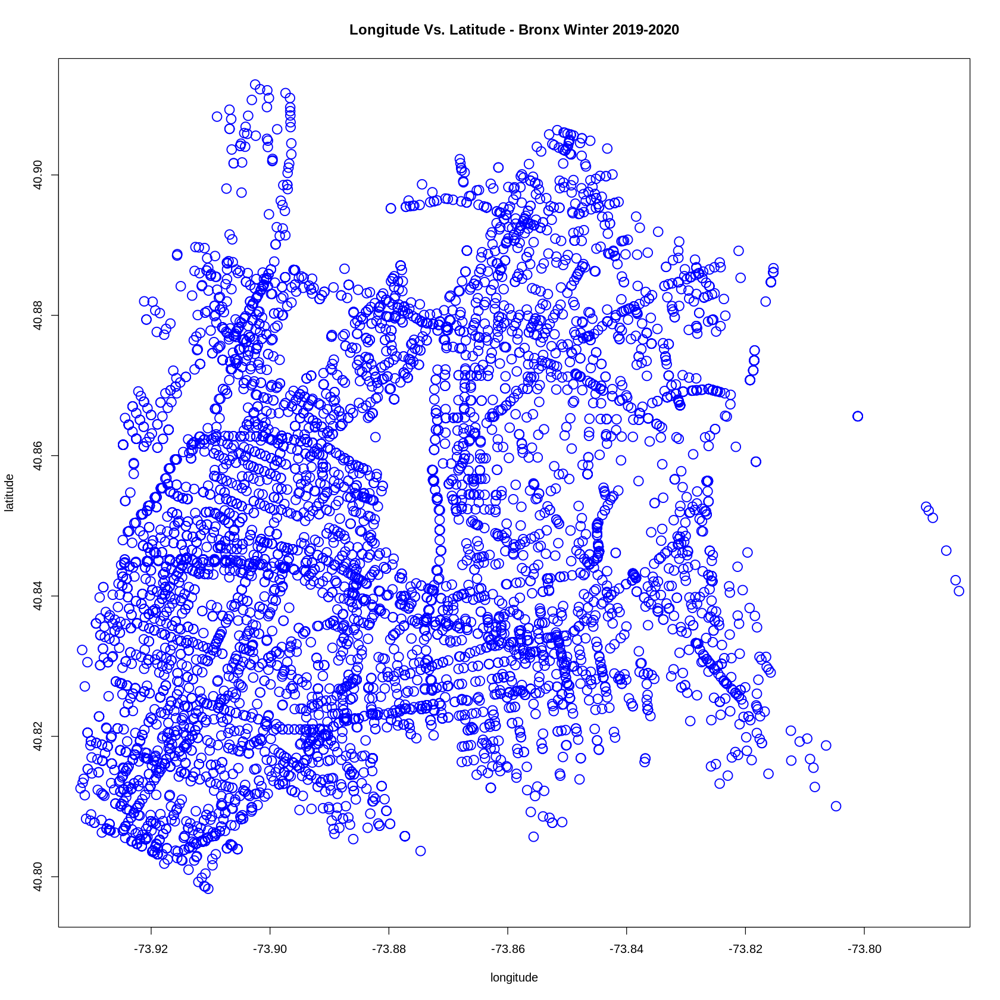

In [105]:
plot(bronx_winter_2019_2020$longitude, bronx_winter_2019_2020$latitude, xlim=c(-73.9299,-73.7879), ylim=c(40.7974,40.912), xlab = "longitude", ylab = "latitude", 
pch = 1, cex=1.75, col="blue", lwd=1.5, main="Longitude Vs. Latitude - Bronx Winter 2019-2020")

**Bronx Summer Months 2020**

In [81]:
  bronx_summer_2020 <- read.csv("https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-bronx_summer_2020.csv")

In [82]:
head(bronx_summer_2020)

,collision_date,latitude,longitude,zip_code,contributing_factor_vehicle_1
,<chr>,<dbl>,<dbl>,<int>,<chr>
1,2020-06-01,40.80426,-73.91349,NA,Unspecified
2,2020-06-01,40.83451,-73.91772,10456,Pavement Defective
3,2020-06-01,40.84574,-73.88784,10460,Brakes Defective
4,2020-06-01,40.81263,-73.88313,10474,Unspecified
5,2020-06-01,40.82371,-73.87900,NA,Following Too Closely
6,2020-06-01,40.81788,-73.89333,10459,Unspecified


In [83]:
summary(bronx_summer_2020)

 collision_date        latitude       longitude         zip_code    
 Length:4890        Min.   :40.80   Min.   :-73.93   Min.   :10451  
 Class :character   1st Qu.:40.83   1st Qu.:-73.91   1st Qu.:10456  
 Mode  :character   Median :40.84   Median :-73.89   Median :10460  
                    Mean   :40.85   Mean   :-73.89   Mean   :10462  
                    3rd Qu.:40.86   3rd Qu.:-73.86   3rd Qu.:10467  
                    Max.   :40.91   Max.   :-73.78   Max.   :10475  
                    NA's   :141     NA's   :141      NA's   :1206   
 contributing_factor_vehicle_1
 Length:4890                  
 Class :character             
 Mode  :character             
                              
                              
                              
                              

In [84]:
nrow(bronx_summer_2020)

[1] 4890

Total number of collision for the Bronx during summer = **4890**

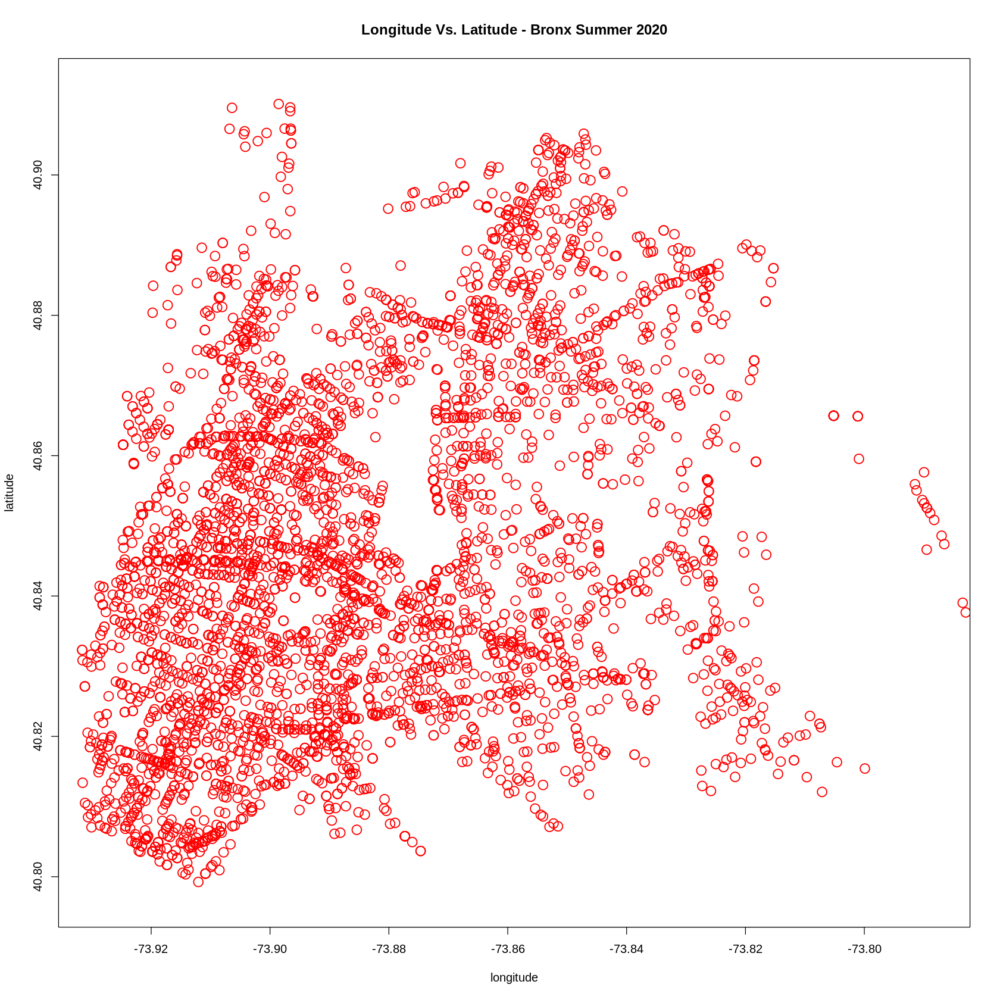

In [106]:
plot(bronx_summer_2020$longitude, bronx_summer_2020$latitude, xlim=c(-73.9299,-73.7879), ylim=c(40.7974,40.912),  xlab = "longitude", ylab = "latitude", 
pch = 1, cex=1.75, col="red", lwd=1.5, main="Longitude Vs. Latitude - Bronx Summer 2020")

From examination of the Bronx data, it is clear that for both summer and winter collsions there is a high density area to the west whose identification may be helpful.


In [186]:
# Initialise URL Variable
map.url <- "https://www.mapquestapi.com/staticmap/v5/map?key=HaI8dvLBtirhMstWmwrcbkRmltyyHAT2&locations=40.844471,-73.902786&size=1100,500@2x"

In [187]:
get_map <- GET(map.url)
get_map

Response [https://www.mapquestapi.com/staticmap/v5/map?key=HaI8dvLBtirhMstWmwrcbkRmltyyHAT2&locations=40.844471,-73.902786&size=1100,500@2x]
  Date: 2020-12-07 19:10
  Status: 200
  Content-Type: image/jpeg
  Size: 1.58 MB
<BINARY BODY>
NULL

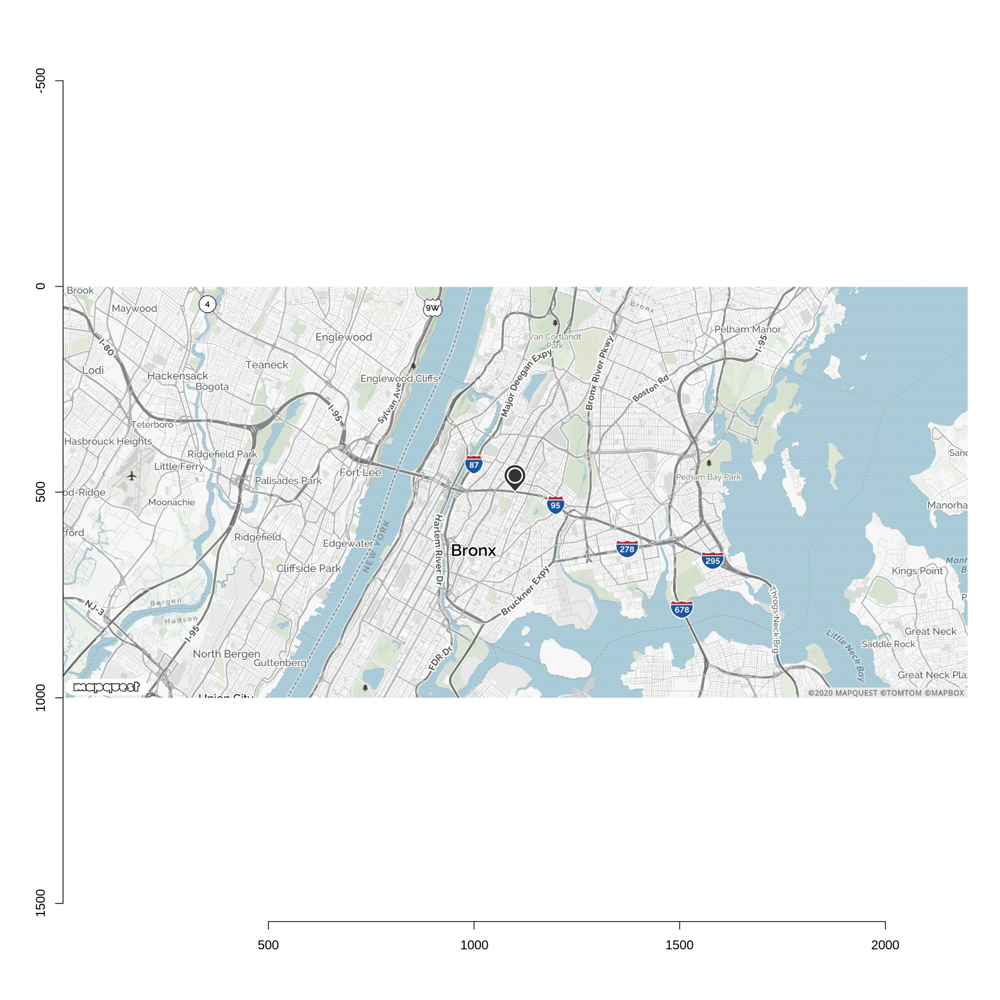

In [188]:
temp <- tempfile(pattern = "file", fileext = ".jpg")
download.file(map.url,temp,mode="wb")
im<-load.image(temp) 
plot(im)

From examination of the map area of the hotspot, it appears that a highway junction is responsible for a high density area of collision within the Bronx.

# Brooklyn

**Query - Create view of Brooklyn collision data based on lat and lon**

```
CREATE VIEW `uhi-project-289113.assignment_guide.ALL_BROOKLYN`
AS SELECT CAST(timestamp as DATE) as collision_date, latitude, longitude, zip_code, contributing_factor_vehicle_1
FROM `bigquery-public-data.new_york_mv_collisions.nypd_mv_collisions` 
WHERE NOT (latitude IS NULL OR latitude = 0.0 AND longitude IS NULL OR longitude = 0.0) 
AND latitude > 40.571666 AND longitude < -73.853655 AND latitude < 40.715472 AND longitude > -74.041122
AND borough IS NULL 
OR borough LIKE 'BROOKLYN'
order by timestamp asc
```

**Query - View summer and winter seasonal data**
```
#standardSql
SELECT * FROM `uhi-project-289113.assignment_guide.ALL_BROOKLYN`
WHERE collision_date BETWEEN '2019-12-01' AND '2020-03-01';
```
https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-brooklyn_winter_2019-2020.csv

```
#standardSql
SELECT * FROM `uhi-project-289113.assignment_guide.ALL_BROOKLYN`
WHERE collision_date BETWEEN '2020-06-01' AND '2020-09-01';
```
https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-brooklyn_summer_2020.csv

**Brooklyn Winter Months 2019-2020**

In [100]:
brooklyn_winter_2019_2020 <- read.csv("https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-brooklyn_winter_2019-2020.csv")

In [101]:
head(brooklyn_winter_2019_2020)

,collision_date,latitude,longitude,zip_code,contributing_factor_vehicle_1
,<chr>,<dbl>,<dbl>,<int>,<chr>
1,2019-12-01,40.67627,-73.93877,NA,Driver Inattention/Distraction
2,2019-12-01,40.65610,-73.93909,11203,Driver Inattention/Distraction
3,2019-12-01,40.69630,-73.96268,11205,Other Vehicular
4,2019-12-01,40.65606,-73.93957,NA,Aggressive Driving/Road Rage
5,2019-12-01,40.63467,-73.99607,11219,Unsafe Speed
6,2019-12-01,40.60081,-73.95937,11229,Backing Unsafely


In [102]:
summary(brooklyn_winter_2019_2020)

 collision_date        latitude       longitude         zip_code    
 Length:13308       Min.   : 0.00   Min.   :-74.04   Min.   :11201  
 Class :character   1st Qu.:40.63   1st Qu.:-73.98   1st Qu.:11208  
 Mode  :character   Median :40.66   Median :-73.95   Median :11218  
                    Mean   :40.65   Mean   :-73.94   Mean   :11220  
                    3rd Qu.:40.68   3rd Qu.:-73.92   3rd Qu.:11230  
                    Max.   :40.82   Max.   :  0.00   Max.   :11421  
                    NA's   :214     NA's   :214      NA's   :3432   
 contributing_factor_vehicle_1
 Length:13308                 
 Class :character             
 Mode  :character             
                              
                              
                              
                              

In [181]:
nrow(brooklyn_winter_2019_2020)

[1] 13308

Total number of collisions for Brooklyn during winter = **13308**

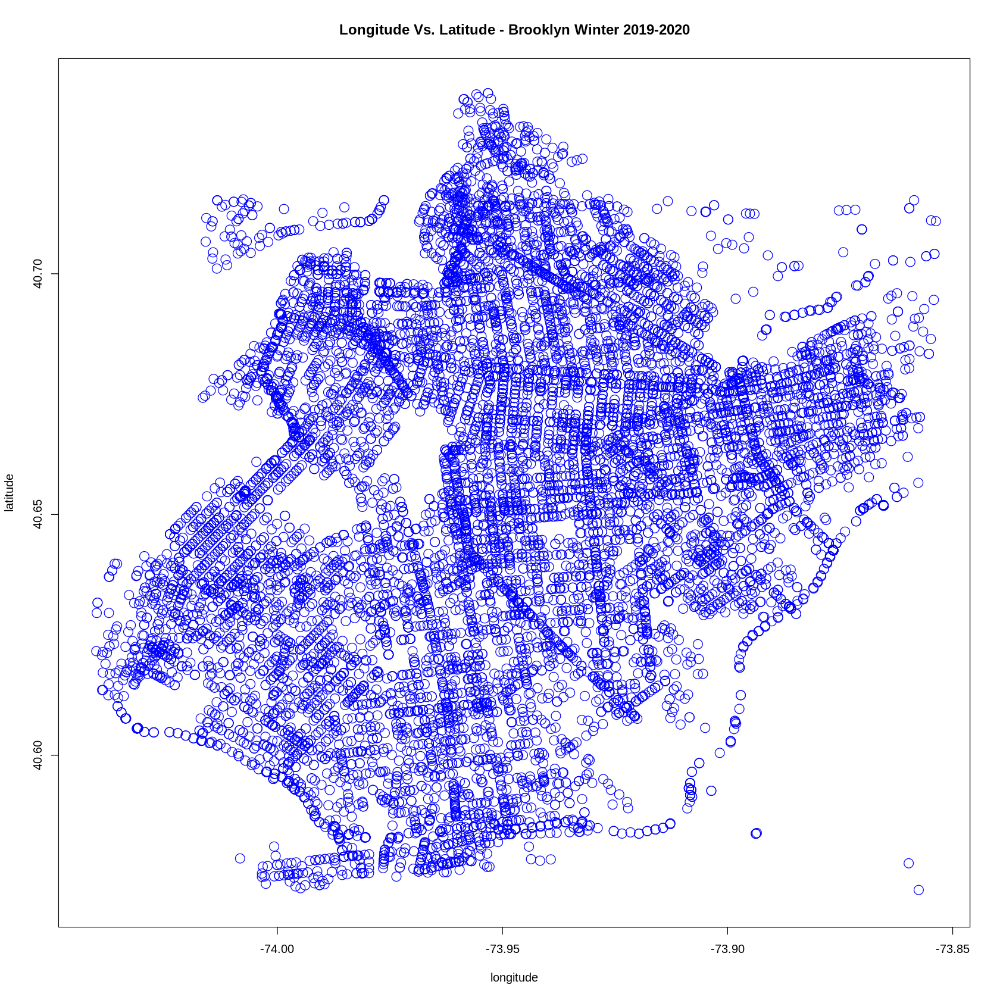

In [108]:
plot(brooklyn_winter_2019_2020$longitude, brooklyn_winter_2019_2020$latitude, xlim=c(-74.0411,-73.853655), ylim=c(40.571,40.738),  
xlab = "longitude", ylab = "latitude",  pch = 1, cex=1.75, col="blue", lwd=1, main="Longitude Vs. Latitude - Brooklyn Winter 2019-2020")

**Brooklyn Summer Months 2020**

In [92]:
brooklyn_summer_2020 <- read.csv("https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-brooklyn_summer_2020.csv")

In [ ]:
head(brooklyn_summer_2020)

,collision_date,latitude,longitude,zip_code,contributing_factor_vehicle_1
,<chr>,<dbl>,<dbl>,<int>,<chr>
1,2020-06-01,40.67894,-74.00191,11231,Driver Inattention/Distraction
2,2020-06-01,40.67715,-73.86887,NA,Other Vehicular
3,2020-06-01,40.65621,-73.93088,11203,Unspecified
4,2020-06-01,40.71697,-73.96080,11249,Aggressive Driving/Road Rage
5,2020-06-01,40.68983,-73.97863,11201,Traffic Control Disregarded
6,2020-06-01,40.67816,-73.89748,NA,Unspecified


In [ ]:
summary(brooklyn_summer_2020)

 collision_date        latitude       longitude         zip_code    
 Length:8582        Min.   : 0.00   Min.   :-74.04   Min.   :11201  
 Class :character   1st Qu.:40.64   1st Qu.:-73.97   1st Qu.:11208  
 Mode  :character   Median :40.66   Median :-73.95   Median :11218  
                    Mean   :40.65   Mean   :-73.93   Mean   :11219  
                    3rd Qu.:40.68   3rd Qu.:-73.92   3rd Qu.:11230  
                    Max.   :40.74   Max.   :  0.00   Max.   :11421  
                    NA's   :140     NA's   :140      NA's   :2270   
 contributing_factor_vehicle_1
 Length:8582                  
 Class :character             
 Mode  :character             
                              
                              
                              
                              

In [ ]:
nrow(brooklyn_summer_2020)

[1] 8582

Total number of collisions for Brooklyn during summer = **8582**

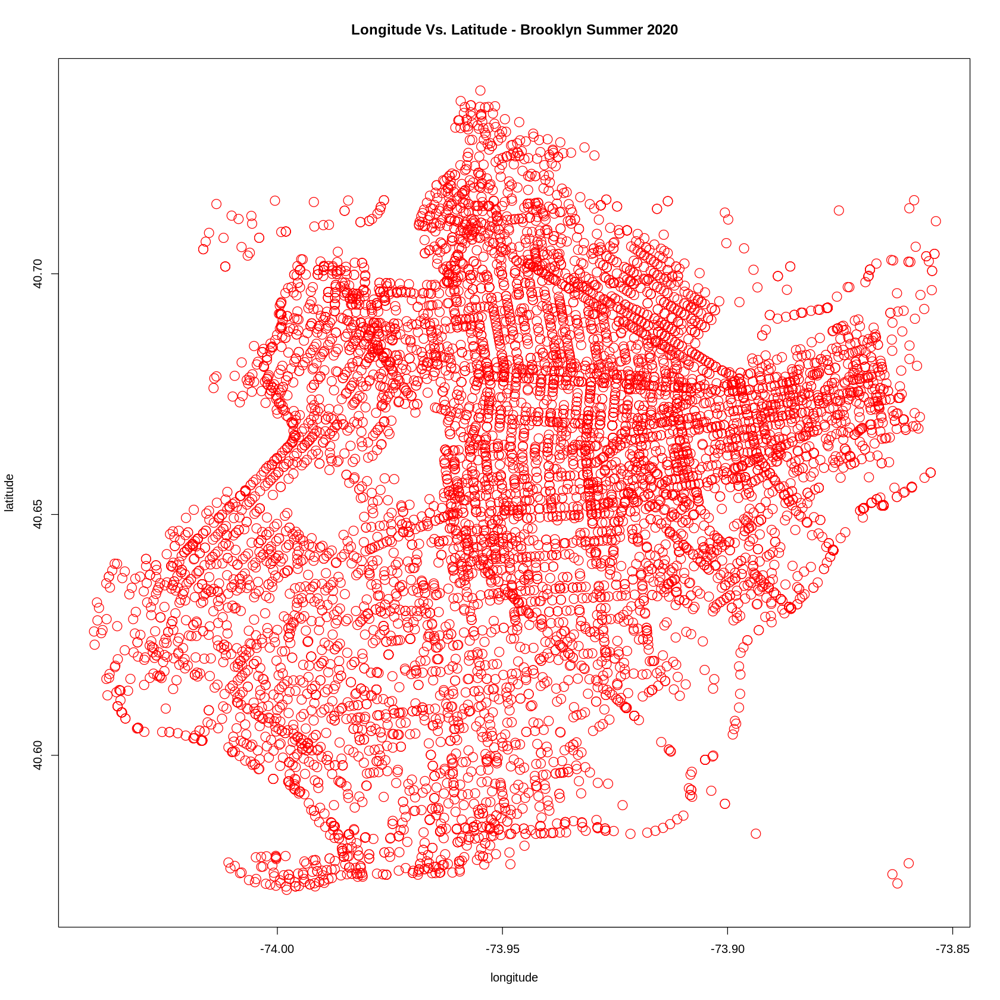

In [107]:
plot(brooklyn_summer_2020$longitude, brooklyn_summer_2020$latitude, xlim=c(-74.0411,-73.853655), ylim=c(40.571,40.738), 
xlab = "longitude", ylab = "latitude",  pch = 1, cex=1.75, col="red", lwd=1, main="Longitude Vs. Latitude - Brooklyn Summer 2020")

From examination of the high density region within Brooklyn, it can be seen that a highway junction is responsible for the high number of collision in this area.

From examination of the Brooklyn data, it is clear that for both summer and winter collsions there is also a high density area to the north whose identification may be helpful.

In [189]:
# Initialise URL Variable
map.url <- "https://www.mapquestapi.com/staticmap/v5/map?key=HaI8dvLBtirhMstWmwrcbkRmltyyHAT2&locations=40.709988,-73.956706&size=1100,500@2x"

In [190]:
get_map <- GET(map.url)
get_map

Response [https://www.mapquestapi.com/staticmap/v5/map?key=HaI8dvLBtirhMstWmwrcbkRmltyyHAT2&locations=40.709988,-73.956706&size=1100,500@2x]
  Date: 2020-12-07 19:13
  Status: 200
  Content-Type: image/jpeg
  Size: 1.77 MB
<BINARY BODY>
NULL

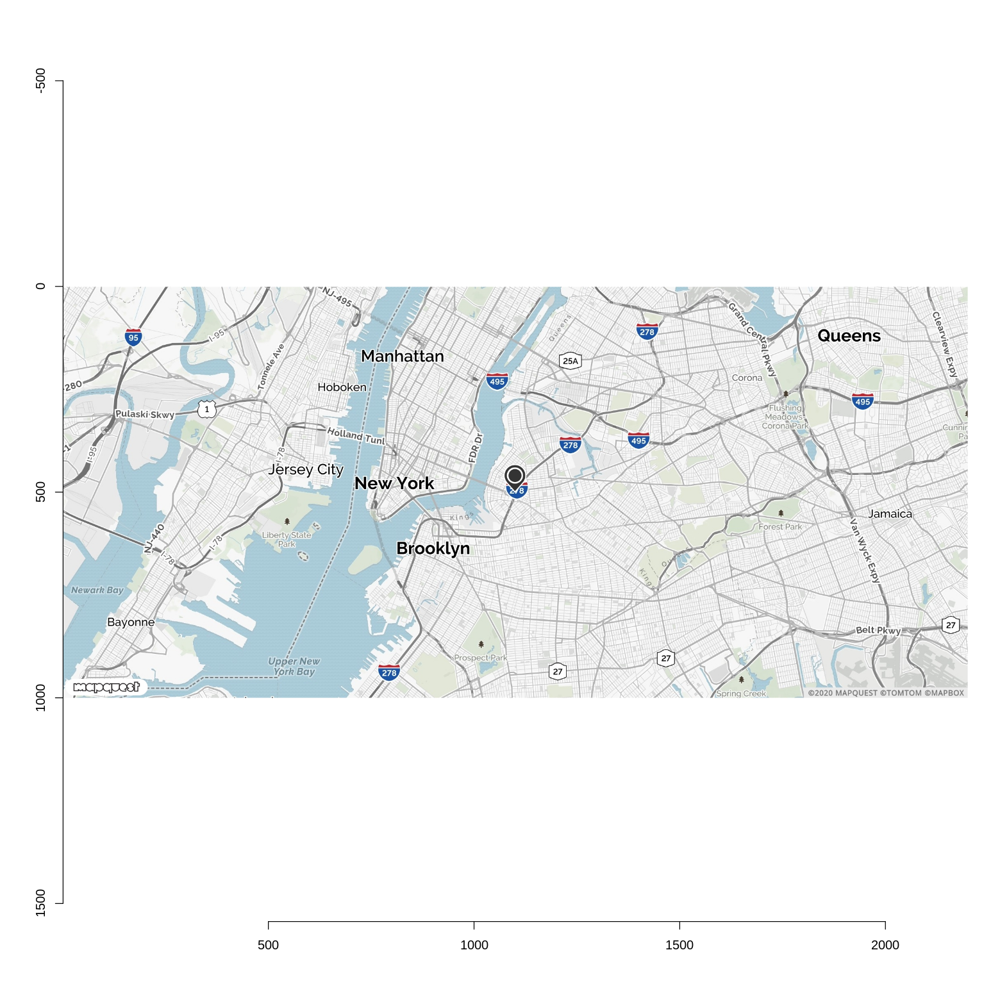

In [191]:
temp <- tempfile(pattern = "file", fileext = ".jpg")
download.file(map.url,temp,mode="wb")
im<-load.image(temp) 
plot(im)

# Staten Island

**Query - Create view of Staten Island collision data based on lat and lon**

```
CREATE VIEW `uhi-project-289113.assignment_guide.ALL_STATEN_ISLAND`
AS SELECT CAST(timestamp as DATE) as collision_date, latitude, longitude, zip_code, contributing_factor_vehicle_1
FROM `bigquery-public-data.new_york_mv_collisions.nypd_mv_collisions` 
WHERE NOT (latitude IS NULL OR latitude = 0.0 AND longitude IS NULL OR longitude = 0.0) 
AND latitude > 40.477399 AND longitude < -74.053696 AND latitude < 40.651812 AND longitude > -74.25909
AND borough IS NULL 
OR borough LIKE 'STATEN ISLAND'
order by timestamp asc
```

**Query - View summer and winter seasonal data**
```
#standardSql
SELECT * FROM `uhi-project-289113.assignment_guide.ALL_STATEN_ISLAND`
WHERE collision_date BETWEEN '2019-12-01' AND '2020-03-01';
```
https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-staten_island_winter_2019-2020.csv

```
#standardSql
SELECT * FROM `uhi-project-289113.assignment_guide.ALL_STATEN_ISLAND`
WHERE collision_date BETWEEN '2020-06-01' AND '2020-09-01';
```

https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-staten_island_summer_2020.csv

**Staten Island -  Winter Months 2019-2020**

In [111]:
staten_island_winter_2019_2020 <- read.csv("https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-staten_island_winter_2019-2020.csv")

In [112]:
head(staten_island_winter_2019_2020)

,collision_date,latitude,longitude,zip_code,contributing_factor_vehicle_1
,<chr>,<dbl>,<dbl>,<int>,<chr>
1,2019-12-01,40.63628,-74.14027,NA,Driver Inattention/Distraction
2,2019-12-01,40.60693,-74.06088,10305,Unspecified
3,2019-12-01,40.62083,-74.08190,10304,Unspecified
4,2019-12-01,NA,NA,10309,Other Vehicular
5,2019-12-01,40.63726,-74.12167,10310,Unspecified
6,2019-12-01,40.58479,-74.08850,10305,Driver Inattention/Distraction


In [ ]:
summary(staten_island_winter_2019_2020)

 collision_date        latitude       longitude         zip_code    
 Length:1297        Min.   :40.50   Min.   :-74.25   Min.   :10301  
 Class :character   1st Qu.:40.57   1st Qu.:-74.16   1st Qu.:10304  
 Mode  :character   Median :40.61   Median :-74.13   Median :10306  
                    Mean   :40.60   Mean   :-74.13   Mean   :10307  
                    3rd Qu.:40.62   3rd Qu.:-74.10   3rd Qu.:10310  
                    Max.   :40.65   Max.   :-74.06   Max.   :10314  
                    NA's   :25      NA's   :25       NA's   :586    
 contributing_factor_vehicle_1
 Length:1297                  
 Class :character             
 Mode  :character             
                              
                              
                              
                              

In [ ]:
nrow(staten_island_winter_2019_2020)

[1] 1940

Total number of collisions for Staten Island during winter = **1940**

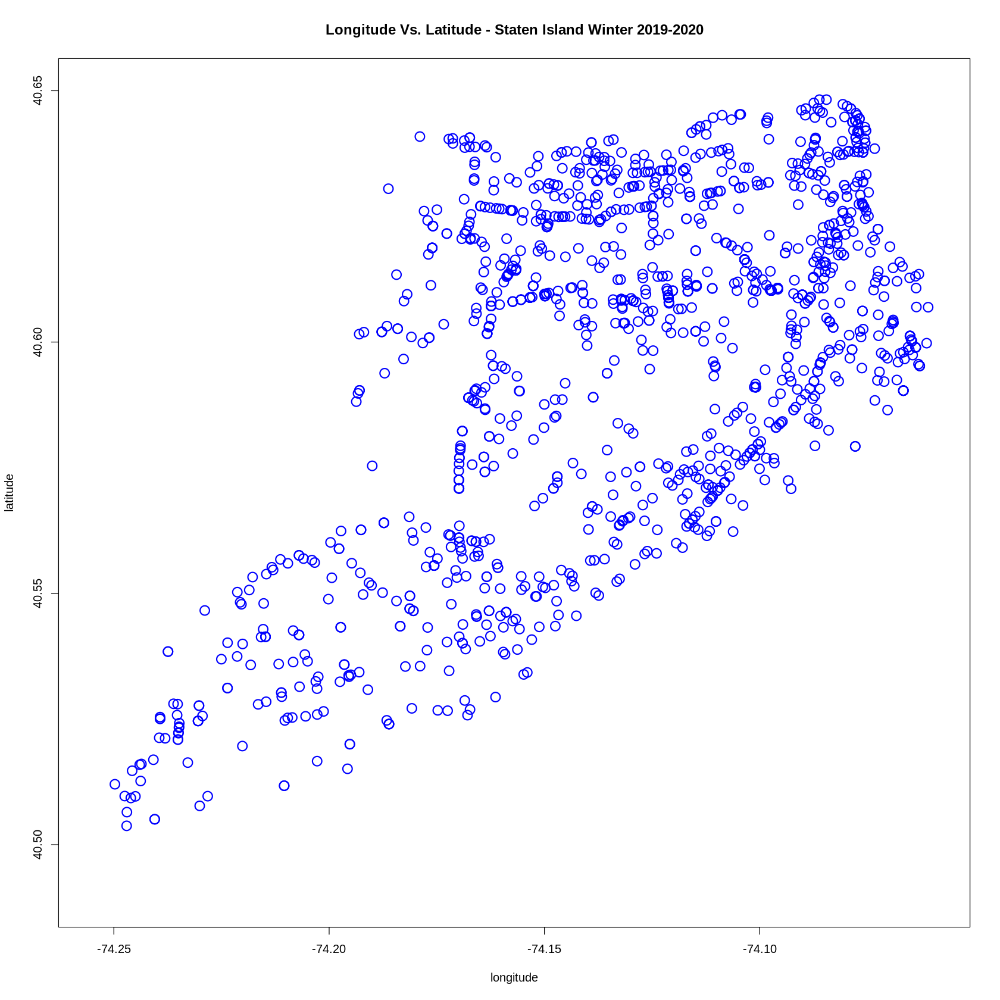

In [113]:
plot(staten_island_winter_2019_2020$longitude, staten_island_winter_2019_2020$latitude, xlim=c(-74.255,-74.059), ylim=c(40.49,40.65), 
xlab = "longitude", ylab = "latitude",  pch = 1, cex=1.75, col="blue", lwd=1.75, main="Longitude Vs. Latitude - Staten Island Winter 2019-2020")

It can be seen from the image above, that the number of collisions within Staten Island increases over the winter months compared to the summer months and in particular, the density of collisions along the north east of the island increases.  This area of Staten Island is significant for commuting and travel between Staten Island and both the rest of New York city and Jersey, and includes the main ferry ports and bridge connections.  

**Staten Island - Summer Months 2020**

Query - Filter all Staten Island Data to obtain summer 2020 collision data.
```
#standardSql
SELECT * FROM `uhi-project-289113.assignment_guide.ALL_STATEN_ISLAND` 
WHERE collision_date BETWEEN '2020-06-01' AND '2020-09-01';
```

In [109]:
staten_island_summer_2020 <- read.csv("https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-staten_island_summer_2020.csv")

In [ ]:
head(staten_island_summer_2020)

,collision_date,latitude,longitude,zip_code,contributing_factor_vehicle_1
,<chr>,<dbl>,<dbl>,<int>,<chr>
1,2020-06-01,40.58124,-74.09845,10306,Driver Inattention/Distraction
2,2020-06-01,40.55415,-74.21790,10309,Unsafe Speed
3,2020-06-02,40.62656,-74.14075,NA,Driver Inattention/Distraction
4,2020-06-02,40.56015,-74.19968,NA,Unspecified
5,2020-06-02,40.52362,-74.19955,10309,Passing Too Closely
6,2020-06-02,40.52257,-74.19001,10312,Failure to Yield Right-of-Way


In [ ]:
summary(staten_island_summer_2020)

 collision_date        latitude       longitude         zip_code    
 Length:1076        Min.   : 0.00   Min.   :-74.25   Min.   :10301  
 Class :character   1st Qu.:40.57   1st Qu.:-74.16   1st Qu.:10304  
 Mode  :character   Median :40.61   Median :-74.13   Median :10306  
                    Mean   :40.56   Mean   :-74.06   Mean   :10306  
                    3rd Qu.:40.63   3rd Qu.:-74.09   3rd Qu.:10309  
                    Max.   :40.65   Max.   :  0.00   Max.   :10314  
                    NA's   :21      NA's   :21       NA's   :462    
 contributing_factor_vehicle_1
 Length:1076                  
 Class :character             
 Mode  :character             
                              
                              
                              
                              

In [ ]:
nrow(staten_island_summer_2020)

[1] 1076

Total number of collisions for Staten Island during summer = **1076**

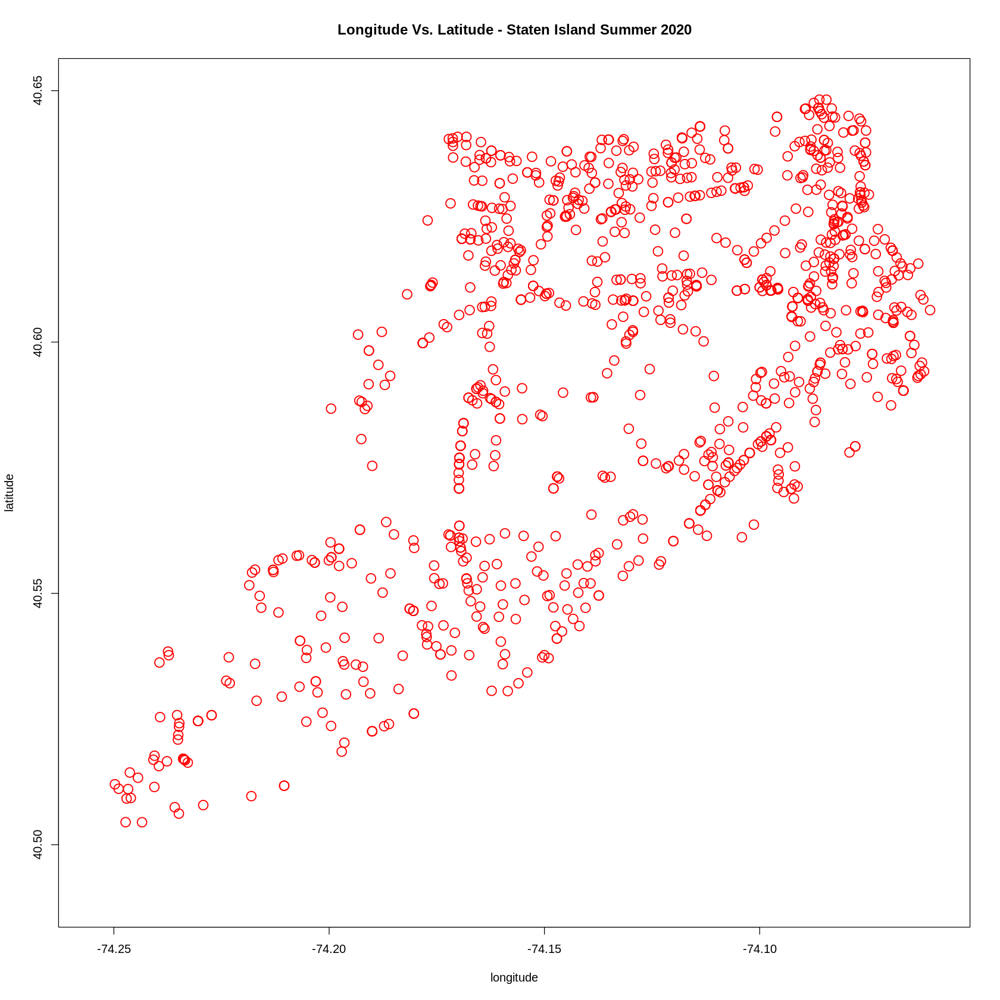

In [110]:
plot(staten_island_summer_2020$longitude, staten_island_summer_2020$latitude, xlim=c(-74.255,-74.059), ylim=c(40.49,40.65), 
xlab = "longitude", ylab = "latitude",  pch = 1, cex=1.75, col="red", lwd=1.5, main="Longitude Vs. Latitude - Staten Island Summer 2020")

From both the summer and winter collision data for Staten island, it appears that there is a much larger number of collisions in the top corner of the island that needs further investigation.

**Staten Island bridges and main ferry port**

In [152]:
# Initialise URL Variable
map.url <- "https://www.mapquestapi.com/staticmap/v5/map?key=HaI8dvLBtirhMstWmwrcbkRmltyyHAT2&locations=40.606616,-74.04466||40.642235,-74.142197||40.644098,-74.072549&size=1100,500@2x"


In [153]:
get_map <- GET(map.url)

In [154]:
get_map

Response [https://www.mapquestapi.com/staticmap/v5/map?key=HaI8dvLBtirhMstWmwrcbkRmltyyHAT2&locations=40.606616,-74.04466||40.642235,-74.142197||40.644098,-74.072549&size=1100,500@2x]
  Date: 2020-12-07 15:49
  Status: 200
  Content-Type: image/jpeg
  Size: 1.44 MB
<BINARY BODY>
NULL

Display map image

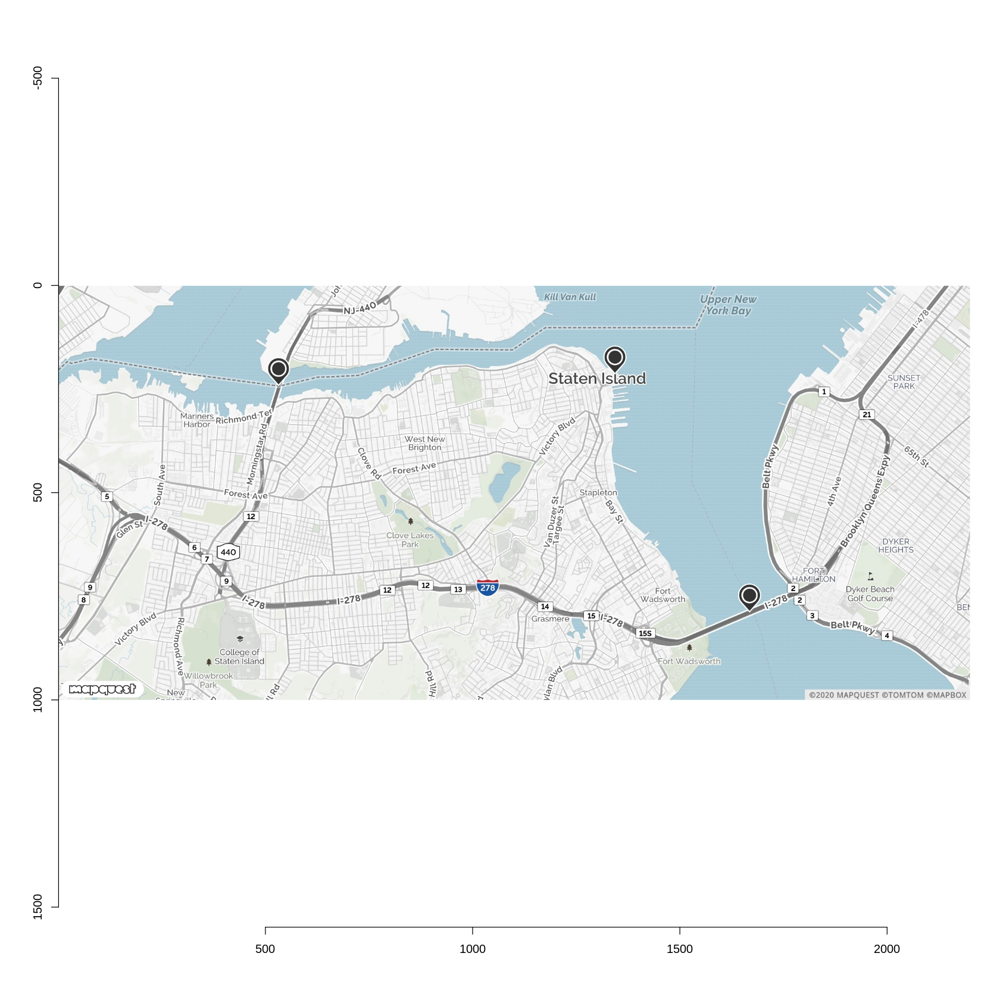

In [155]:
temp <- tempfile(pattern = "file", fileext = ".jpg")
download.file(map.url,temp,mode="wb")
im<-load.image(temp) 
plot(im)

From exploration of the geography of the top corner of Staten island, it is likely that increased traffic around the main arterial links between Staten Island and the rest of NYC, such as the main ferry port and bridges, are the reason that a large number of collisions occur within this area comapred to the rest of the island.

# Manhattan

**Query - Create view of Staten Island collision data based on lat and lon**

```
#standardSql
CREATE VIEW `uhi-project-289113.assignment_guide.ALL_MANHATTAN`
AS SELECT CAST(timestamp as DATE) as collision_date, latitude, longitude, zip_code, contributing_factor_vehicle_1
FROM `bigquery-public-data.new_york_mv_collisions.nypd_mv_collisions` 
WHERE NOT (latitude IS NULL OR latitude = 0.0 AND longitude IS NULL OR longitude = 0.0) 
AND latitude > 40.700473 AND longitude < -73.928553 AND latitude < 40.849346 AND longitude > -74.019926
AND borough IS NULL 
OR borough LIKE 'MANHATTAN'
order by timestamp asc
```

**Query - View summer and winter seasonal data**
```
#standardSql
SELECT * FROM `uhi-project-289113.assignment_guide.ALL_MANHATTAN`
WHERE collision_date BETWEEN '2019-12-01' AND '2020-03-01';
```
https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-manhattan_winter_2019-2020.csv

```
#standardSql
SELECT * FROM `uhi-project-289113.assignment_guide.ALL_MANHATTAN`
WHERE collision_date BETWEEN '2020-06-01' AND '2020-09-01';
```

https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-manhattan_summer_2020.csv

**Manhattan - Winter Months 2019-2020**

In [ ]:
manhattan_winter_2019_2020 <- read.csv("https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-manhattan_winter_2019-2020.csv")

In [ ]:
head(manhattan_winter_2019_2020)

,collision_date,latitude,longitude,zip_code,contributing_factor_vehicle_1
,<chr>,<dbl>,<dbl>,<int>,<chr>
1,2019-12-01,40.72190,-73.98530,10002,Obstruction/Debris
2,2019-12-01,40.75178,-73.98656,10018,Passenger Distraction
3,2019-12-01,40.79349,-73.94328,NA,Driver Inattention/Distraction
4,2019-12-01,40.75845,-73.98672,10036,Backing Unsafely
5,2019-12-01,40.81417,-73.93431,NA,Unspecified
6,2019-12-01,40.71330,-73.96742,NA,Passenger Distraction


In [ ]:
summary(manhattan_winter_2019_2020)

 collision_date        latitude       longitude         zip_code    
 Length:9805        Min.   : 0.00   Min.   :-74.02   Min.   :10000  
 Class :character   1st Qu.:40.74   1st Qu.:-73.99   1st Qu.:10012  
 Mode  :character   Median :40.76   Median :-73.97   Median :10022  
                    Mean   :40.74   Mean   :-73.92   Mean   :10025  
                    3rd Qu.:40.80   3rd Qu.:-73.94   3rd Qu.:10032  
                    Max.   :40.87   Max.   :  0.00   Max.   :10282  
                    NA's   :217     NA's   :217      NA's   :3734   
 contributing_factor_vehicle_1
 Length:9805                  
 Class :character             
 Mode  :character             
                              
                              
                              
                              

In [ ]:
nrow(manhattan_winter_2019_2020)

[1] 9805

Total number of collisions for Manhattan during winter = **9805**

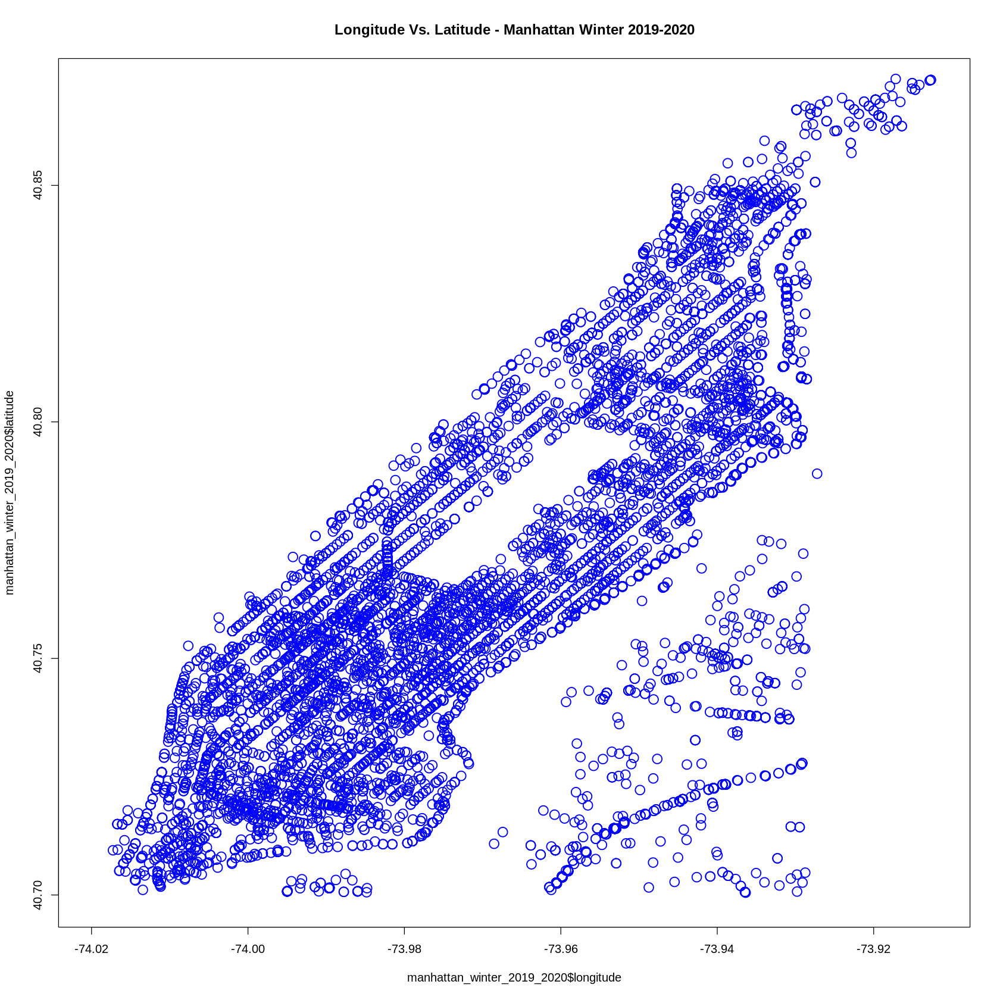

In [ ]:
plot(manhattan_winter_2019_2020$longitude, manhattan_winter_2019_2020$latitude, xlim=c(-74.0199,-73.912), ylim=c(40.70,40.870), pch = 1, cex=1.75, col="blue", lwd=1.5, main="Longitude Vs. Latitude - Manhattan Winter 2019-2020")

**Manhattan Summer Months 2020**

In [ ]:
manhattan_summer_2020 <- read.csv("https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-manhattan_summer_2020.csv")

In [ ]:
head(manhattan_summer_2020)

,collision_date,latitude,longitude,zip_code,contributing_factor_vehicle_1
,<chr>,<dbl>,<dbl>,<int>,<chr>
1,2020-06-01,40.74378,-73.97352,10016,Unspecified
2,2020-06-01,40.76672,-73.96914,10065,Unspecified
3,2020-06-01,40.72117,-73.99658,10012,Driver Inattention/Distraction
4,2020-06-01,40.72424,-73.99779,10012,Outside Car Distraction
5,2020-06-01,40.76307,-73.96970,10022,Unsafe Speed
6,2020-06-01,40.82815,-73.93491,NA,Passing or Lane Usage Improper


In [ ]:
summary(manhattan_summer_2020)

 collision_date        latitude       longitude         zip_code    
 Length:3927        Min.   :40.70   Min.   :-74.02   Min.   :10000  
 Class :character   1st Qu.:40.74   1st Qu.:-73.98   1st Qu.:10013  
 Mode  :character   Median :40.78   Median :-73.95   Median :10026  
                    Mean   :40.78   Mean   :-73.96   Mean   :10028  
                    3rd Qu.:40.81   3rd Qu.:-73.94   3rd Qu.:10033  
                    Max.   :40.87   Max.   :-73.91   Max.   :10282  
                    NA's   :63      NA's   :63       NA's   :1547   
 contributing_factor_vehicle_1
 Length:3927                  
 Class :character             
 Mode  :character             
                              
                              
                              
                              

In [ ]:
nrow(manhattan_summer_2020)

[1] 3927

Total number of collisions for Manhattan during summer = **3927**

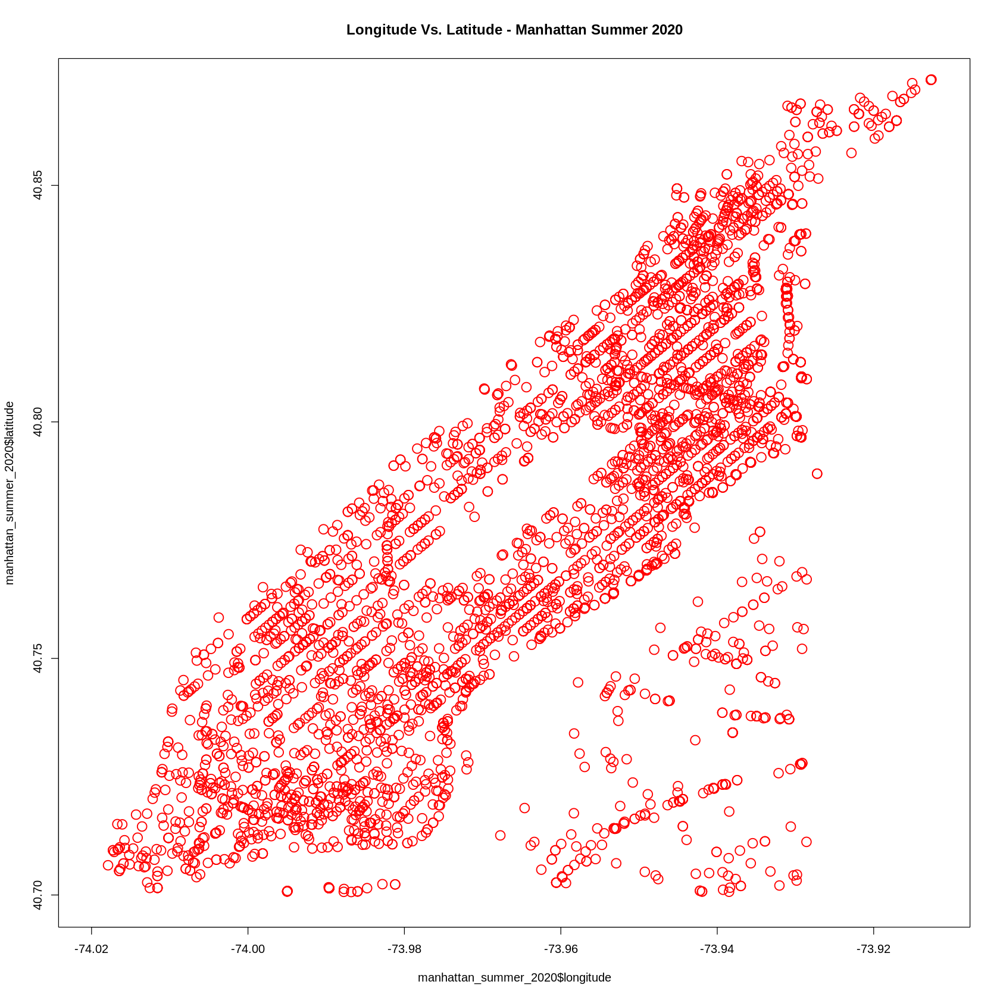

In [ ]:
plot(manhattan_summer_2020$longitude, manhattan_summer_2020$latitude, xlim=c(-74.0199,-73.912), ylim=c(40.70,40.870),  pch = 1, cex=1.75, col="red", lwd=1.5, main="Longitude Vs. Latitude - Manhattan Summer 2020")

From examination of the Manhattan data, two high density regions of collisions can be identified.  Strangely, one area to the north east is responsible for a high number of collisions during summer, and the other to the south west is responsible for a high number of collisions during winter.

In [192]:
# Initialise URL Variable
map.url <- "https://www.mapquestapi.com/staticmap/v5/map?key=HaI8dvLBtirhMstWmwrcbkRmltyyHAT2&locations=40.734394,-73.99556||40.811856,-73.946774&size=1100,500@2x"

In [193]:
get_map <- GET(map.url)
get_map

Response [https://www.mapquestapi.com/staticmap/v5/map?key=HaI8dvLBtirhMstWmwrcbkRmltyyHAT2&locations=40.734394,-73.99556||40.811856,-73.946774&size=1100,500@2x]
  Date: 2020-12-07 19:18
  Status: 200
  Content-Type: image/jpeg
  Size: 1.83 MB
<BINARY BODY>
NULL

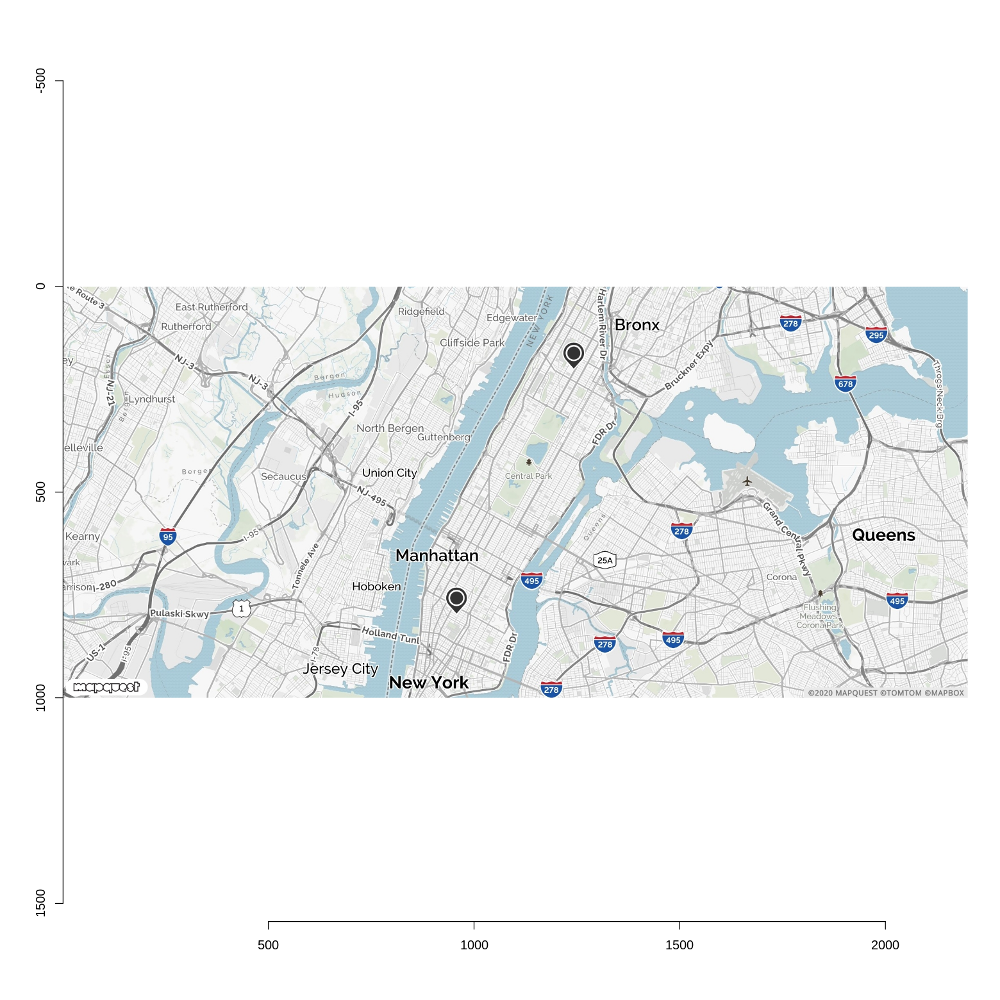

In [194]:
temp <- tempfile(pattern = "file", fileext = ".jpg")
download.file(map.url,temp,mode="wb")
im<-load.image(temp) 
plot(im)

# Queens

**Query - Create view of Staten Island collision data based on lat and lon**

```
#standardSql
CREATE VIEW `uhi-project-289113.assignment_guide.ALL_QUEENS`
AS SELECT CAST(timestamp as DATE) as collision_date, latitude, longitude, zip_code, contributing_factor_vehicle_1
FROM `bigquery-public-data.new_york_mv_collisions.nypd_mv_collisions` 
WHERE NOT (latitude IS NULL OR latitude = 0.0 AND longitude IS NULL OR longitude = 0.0) 
AND latitude > 40.647144 AND longitude < -73.740665 AND latitude < 40.78343 AND longitude > -73.935679
AND borough IS NULL 
OR borough LIKE 'QUEENS'
order by timestamp asc
```

**Query - View summer and winter seasonal data**
```
#standardSql
SELECT * FROM `uhi-project-289113.assignment_guide.ALL_QUEENS`
WHERE collision_date BETWEEN '2019-12-01' AND '2020-03-01';
```
https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-queens_winter_2019-2020.csv

```
#standardSql
SELECT * FROM `uhi-project-289113.assignment_guide.ALL_QUEENS`
WHERE collision_date BETWEEN '2020-06-01' AND '2020-09-01';
```
https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-queens_summer_2020.csv

**Queens Winter Months 2019-2020**

In [136]:
queens_winter_2019_2020 <- read.csv("https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-queens_winter_2019-2020.csv")

In [137]:
head(queens_winter_2019_2020)

,collision_date,latitude,longitude,zip_code,contributing_factor_vehicle_1
,<chr>,<dbl>,<dbl>,<int>,<chr>
1,2019-12-01,40.76041,-73.86422,11369,Driver Inattention/Distraction
2,2019-12-01,40.69778,-73.85133,11421,Driver Inattention/Distraction
3,2019-12-01,40.68665,-73.80918,11420,Passing or Lane Usage Improper
4,2019-12-01,40.69341,-73.74923,11412,Unspecified
5,2019-12-01,40.66956,-73.84634,11414,Other Vehicular
6,2019-12-01,40.70058,-73.80775,NA,Driver Inattention/Distraction


In [ ]:
summary(queens_winter_2019_2020)

 collision_date        latitude       longitude         zip_code    
 Length:17110       Min.   : 0.00   Min.   :-73.96   Min.   :11001  
 Class :character   1st Qu.:40.69   1st Qu.:-73.89   1st Qu.:11367  
 Mode  :character   Median :40.71   Median :-73.83   Median :11385  
                    Mean   :40.68   Mean   :-73.77   Mean   :11375  
                    3rd Qu.:40.75   3rd Qu.:-73.79   3rd Qu.:11422  
                    Max.   :40.80   Max.   :  0.00   Max.   :11697  
                    NA's   :293     NA's   :293      NA's   :5718   
 contributing_factor_vehicle_1
 Length:17110                 
 Class :character             
 Mode  :character             
                              
                              
                              
                              

In [138]:
nrow(queens_winter_2019_2020)

[1] 13372

Total number of collisions for Queens during winter = **13372**

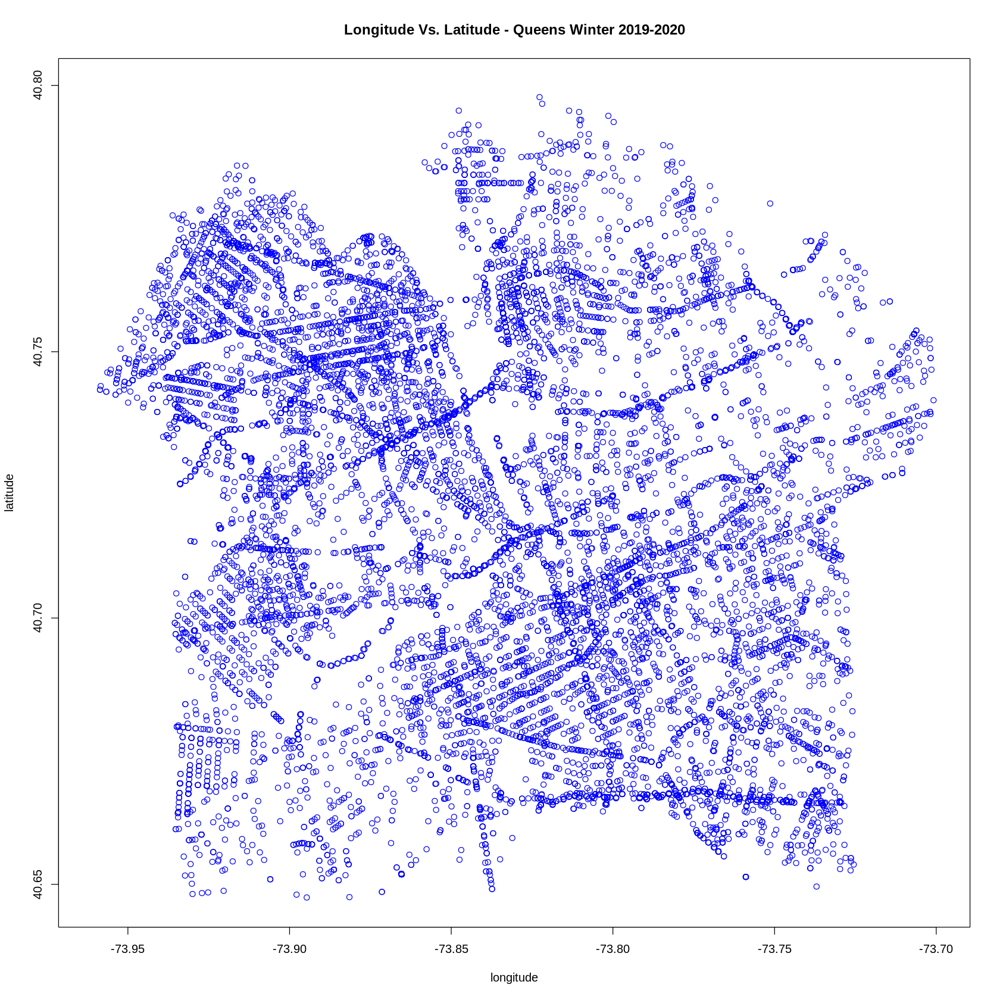

In [139]:
plot(queens_winter_2019_2020$longitude, queens_winter_2019_2020$latitude, xlim=c(-73.961,-73.70), ylim=c(40.648,40.799),
xlab = "longitude", ylab = "latitude", pch = 1, col = rgb(0, 0, 1), main="Longitude Vs. Latitude - Queens Winter 2019-2020")

**Queens Summer Months 2020**

Query


```#standardSql
SELECT * FROM `uhi-project-289113.assignment_guide.ALL_QUEENS`
WHERE collision_date BETWEEN '2020-06-01' AND '2020-09-01';
```

In [182]:
queens_summer_2020 <- read.csv("https://raw.githubusercontent.com/15014370uhi/15014370_DataAnalytics/master/bq-queens_summer_2020.csv")

In [121]:
head(queens_summer_2020)

,collision_date,latitude,longitude,zip_code,contributing_factor_vehicle_1
,<chr>,<dbl>,<dbl>,<int>,<chr>
1,2020-06-01,40.68884,-73.82190,11419,Passing Too Closely
2,2020-06-01,40.58588,-73.82320,11694,Unspecified
3,2020-06-01,40.66484,-73.82229,NA,Unsafe Lane Changing
4,2020-06-01,40.59622,-73.79549,11692,Driver Inattention/Distraction
5,2020-06-01,40.67715,-73.86887,NA,Other Vehicular
6,2020-06-01,40.76912,-73.87635,11369,Illnes


In [183]:
summary(queens_summer_2020)

 collision_date        latitude       longitude         zip_code    
 Length:7411        Min.   : 0.00   Min.   :-73.96   Min.   :11001  
 Class :character   1st Qu.:40.68   1st Qu.:-73.89   1st Qu.:11368  
 Mode  :character   Median :40.71   Median :-73.84   Median :11385  
                    Mean   :40.70   Mean   :-73.81   Mean   :11382  
                    3rd Qu.:40.75   3rd Qu.:-73.79   3rd Qu.:11422  
                    Max.   :40.80   Max.   :  0.00   Max.   :11697  
                    NA's   :135     NA's   :135      NA's   :2569   
 contributing_factor_vehicle_1
 Length:7411                  
 Class :character             
 Mode  :character             
                              
                              
                              
                              

In [184]:
nrow(queens_summer_2020)

[1] 7411

Total number of collisions for Queens during summer = **7411**

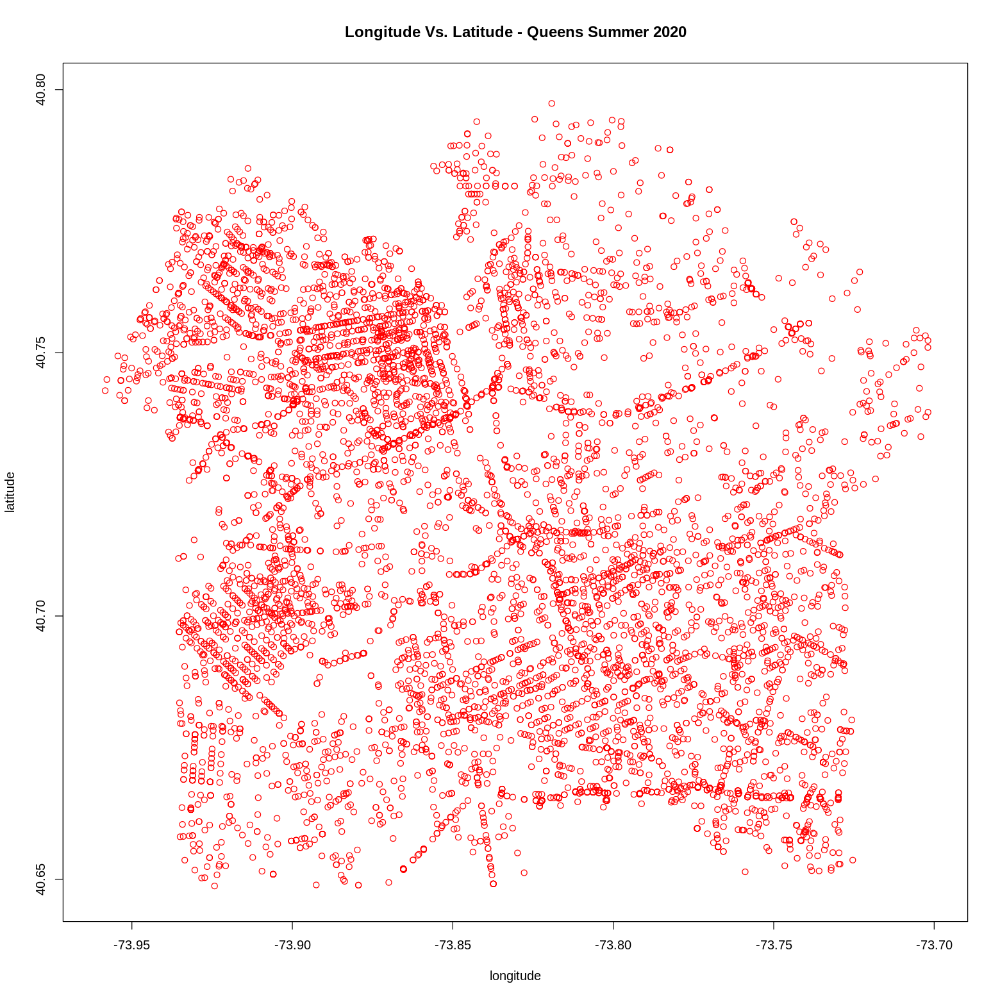

In [185]:
plot(queens_summer_2020$longitude, queens_summer_2020$latitude, xlim=c(-73.961,-73.70), ylim=c(40.648,40.799), 
xlab = "longitude", ylab = "latitude", col="red", main="Longitude Vs. Latitude - Queens Summer 2020")

It can be seen from the above image, that collision locations trace the path of major roadways through Queens, perhaps larger roads with more traffic lanes result in denser traffic with a greater numbers of collisions.  In particular, two high collision density areas stand out, whose identification could be useful. 

In [195]:
# Initialise URL Variable
map.url <- "https://www.mapquestapi.com/staticmap/v5/map?key=HaI8dvLBtirhMstWmwrcbkRmltyyHAT2&locations=40.734518,-73.922311||40.709755,-73.819885&size=1100,500@2x"

In [196]:
get_map <- GET(map.url)
get_map

Response [https://www.mapquestapi.com/staticmap/v5/map?key=HaI8dvLBtirhMstWmwrcbkRmltyyHAT2&locations=40.734518,-73.922311||40.709755,-73.819885&size=1100,500@2x]
  Date: 2020-12-07 19:20
  Status: 200
  Content-Type: image/jpeg
  Size: 1.69 MB
<BINARY BODY>
NULL

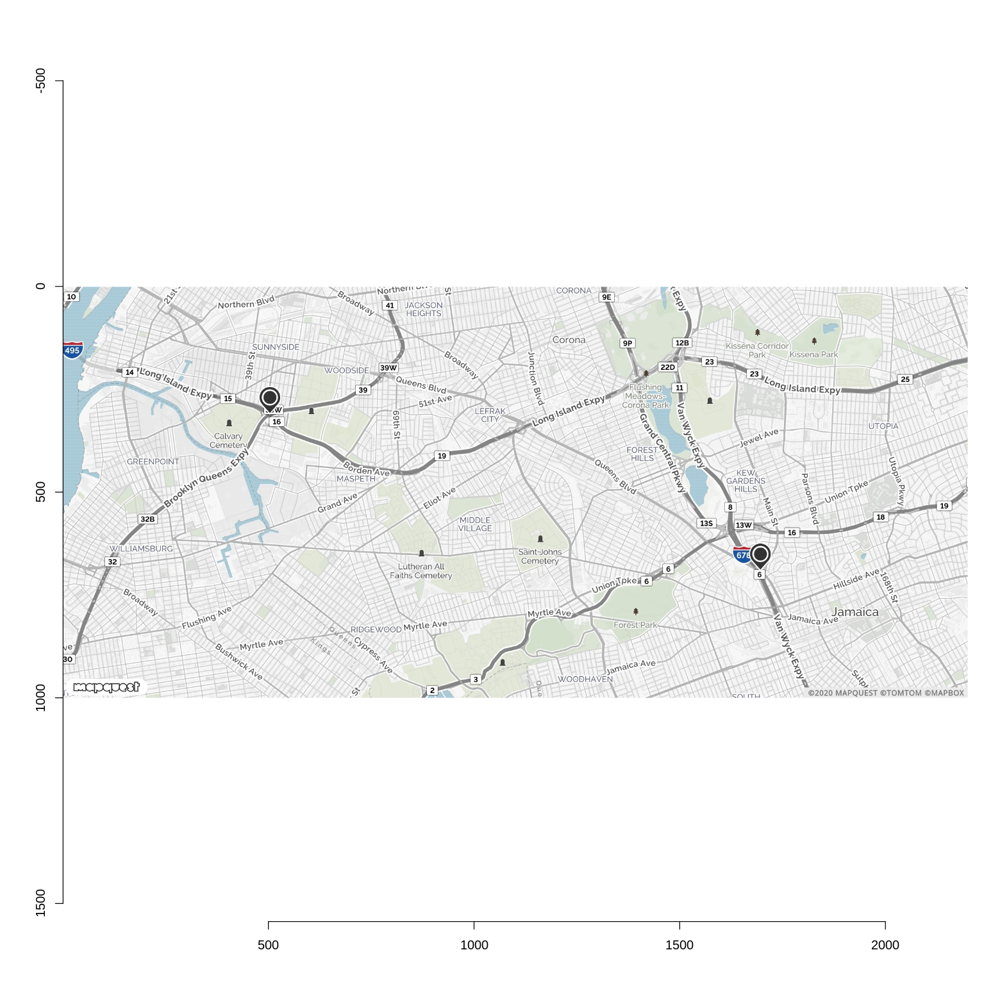

In [197]:
temp <- tempfile(pattern = "file", fileext = ".jpg")
download.file(map.url,temp,mode="wb")
im<-load.image(temp) 
plot(im)

It is clear from the above map, that like other boroughs, highway junctions appear to be responsible for regions of high collision density.

# **Conclusion**

From examination of the different datasets, the folowing recommendations that can be made to help inform emergency services in NYC.

**Injury and Deaths**

It was seen that for all boroughs, although the number of collisions increases significantly over the winter months, conversely, the number of injuries and deaths per collision was surprisingly less than during the summer months.  Emergency services should be prepared for greater numbers of injuries and deaths during the summer months.

**Boroughs**

During investigation of the differences between boroughs for summer weather and winter weather, it was clear that some boroughs had far less collisions and collision density than others and some were more heavily influenced by seasonal weather.  For example, Manhattan saw high density collision spots change between winter and summer months and Staten Island saw a large increase in collision density around important arterial travel routes like bridges and ferry ports.  Others like Queens, saw high density of collisions around highway junctions.


**Weather**

Although differences could be identified between summer and winter months in terms of collision numbers, a single specific weather effect had no significant influence on the number of collisions.


**Days of Week**

From examination of the data, it could be seen that collisions became more frequent on specific days.  Fridays was consistently the worst day for collisions followed by the other week days.  The weekend days Saturday and Sunday say a significant reduction in collisions.


**Overall Recommendations**

In summary, the data tells us that the worst day for the number of collisions would be a Friday during the winter months, and the worst location would be highway junctions within Brooklyn.

# References

google.com. (2020) *NYPD Motor Vehicle Collisions* [online]. 
Available from <https://console.cloud.google.com/marketplace/product/city-of-new-york/nypd-mv-collisions?q=search&referrer=search&project=uhi-project-289113> [17 November 2020]